<a href="https://colab.research.google.com/github/MuindeEsther/BootcampProjects/blob/main/Craiglist_Vehicles_Time_Series_Model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## **Time Series Model**
**Craiglist Vehicles Dataset**
Craiglist is the world's ;argest colection of used vehicles for sale. The data contains most all relevant information that Craiglist provides on car sales including columns like price, condition, manufactures, latitude/longitude, and 18 other categories.

**Goal**: Create a Time Series Model to predict car prices

### **Key Steps:**
* Adressing missing values
* Correcting the datatime format
* Create a datetime index
* Exploratory data analysis to understand temporal patterns, Identify  seasonal trends and Analyze demand-supply dynamics by region and vehicle type.
*Build a Time Series Model.



In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import pandas as pd
import matplotlib.pyplot as plt
plt.rcParams["figure.dpi"] = 150 # For higher resolution figures
plt.rcParams['font.size'] = 8 # Lower size of figures font
plt.rcParams['figure.autolayout'] = True
import seaborn as sns
import numpy as np
import statsmodels.api as sm
from statsmodels.tsa.api import ExponentialSmoothing, arima


In [3]:
# Import data
df = pd.read_csv('/content/drive/MyDrive/craigslist_vehicles.csv')
df.head()

,Unnamed: 0,id,url,region,region_url,price,year,manufacturer,model,condition,...,type,paint_color,image_url,description,county,state,lat,long,posting_date,removal_date
0,362773,7307679724,https://abilene.craigslist.org/ctd/d/abilene-2...,abilene,https://abilene.craigslist.org,4500,2002.0,bmw,x5,NaN,...,NaN,NaN,https://images.craigslist.org/00m0m_iba78h8ty9...,"$4,500 Cash 2002 BMW X5 8 cylinder 4.4L moto...",NaN,tx,32.401556,-99.884713,2021-04-16 00:00:00+00:00,2021-05-02 00:00:00+00:00
1,362712,7311833696,https://abilene.craigslist.org/ctd/d/abilene-2...,abilene,https://abilene.craigslist.org,4500,2002.0,bmw,x5,NaN,...,NaN,NaN,https://images.craigslist.org/00m0m_iba78h8ty9...,"$4,500 Cash 2002 BMW X5 8 cylinder 4.4L moto...",NaN,tx,32.401556,-99.884713,2021-04-24 00:00:00+00:00,2021-04-28 00:00:00+00:00
2,362722,7311441996,https://abilene.craigslist.org/ctd/d/abilene-2...,abilene,https://abilene.craigslist.org,4900,2006.0,toyota,camry,excellent,...,sedan,silver,https://images.craigslist.org/00808_5FkOw2aGjA...,2006 TOYOTA CAMRY LE Sedan Ready To Upgrade ...,NaN,tx,32.453848,-99.787900,2021-04-23 00:00:00+00:00,2021-05-25 00:00:00+00:00
3,362771,7307680715,https://abilene.craigslist.org/ctd/d/abilene-2...,abilene,https://abilene.craigslist.org,6500,2008.0,ford,expedition,NaN,...,NaN,NaN,https://images.craigslist.org/00M0M_i9CoFvVq8o...,$6500.00 2008 Ford Expedition 8 cylinder 5.4L...,NaN,tx,32.401556,-99.884713,2021-04-16 00:00:00+00:00,2021-04-26 00:00:00+00:00
4,362710,7311834578,https://abilene.craigslist.org/ctd/d/abilene-2...,abilene,https://abilene.craigslist.org,6500,2008.0,ford,expedition,NaN,...,NaN,NaN,https://images.craigslist.org/00M0M_i9CoFvVq8o...,$6500.00 2008 Ford Expedition 8 cylinder 5.4L...,NaN,tx,32.401556,-99.884713,2021-04-24 00:00:00+00:00,2021-05-12 00:00:00+00:00


### Data Cleanup and Preprocessing

In [4]:
# Check for missing values
missing_values_count = df.isnull().sum()

In [5]:
print(missing_values_count)

Unnamed: 0           0
id                   0
url                  0
region               0
region_url           0
price                0
year              1205
manufacturer     17646
model             5277
condition       174104
cylinders       177678
fuel              3013
odometer          4400
title_status      8242
transmission      2556
VIN             161042
drive           130567
size            306361
type             92858
paint_color     130203
image_url           68
description         70
county          426880
state                0
lat               6549
long              6549
posting_date        68
removal_date        68
dtype: int64


In [6]:
df.shape

(426880, 28)

In [7]:
df.columns

Index(['Unnamed: 0', 'id', 'url', 'region', 'region_url', 'price', 'year',
       'manufacturer', 'model', 'condition', 'cylinders', 'fuel', 'odometer',
       'title_status', 'transmission', 'VIN', 'drive', 'size', 'type',
       'paint_color', 'image_url', 'description', 'county', 'state', 'lat',
       'long', 'posting_date', 'removal_date'],
      dtype='object')

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 28 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   Unnamed: 0    426880 non-null  int64  
 1   id            426880 non-null  int64  
 2   url           426880 non-null  object 
 3   region        426880 non-null  object 
 4   region_url    426880 non-null  object 
 5   price         426880 non-null  int64  
 6   year          425675 non-null  float64
 7   manufacturer  409234 non-null  object 
 8   model         421603 non-null  object 
 9   condition     252776 non-null  object 
 10  cylinders     249202 non-null  object 
 11  fuel          423867 non-null  object 
 12  odometer      422480 non-null  float64
 13  title_status  418638 non-null  object 
 14  transmission  424324 non-null  object 
 15  VIN           265838 non-null  object 
 16  drive         296313 non-null  object 
 17  size          120519 non-null  object 
 18  type

** Description of the columns**
* id - Unique ID given to every Craiglist ad and is the primary key of the dataset
* url - URL of the car sale advertisement on the Craiglist website
* Region - city whre the sale is located
* region_url - Craiglist URL for sales in the region.
* price - Sale price (in US dollars)
* year - The year in which the car was manufactured
* manufacturer - The manufacturer of the car, with 42 unique businesses engaged in the automobile manufacturing.
* model- The exact model of the car, such as "sierra classic 2500hd".
* condition - The condition of the car, which can be new, like new, excellent, good, fair, salvage.
* cylinders - The number of cylinders in the car engine, ranging from 3 to 12, with an "other" category
* fuel - The type of fuel used, including "diesel", "gas","electric","hybrid", and "other".
* odometer - The total number of miles driven by car.
* title_status - The legal status of the vehicle, which can be clean, lien,rebuilt, salvage, parts only, or missing
* transmission - The type of gearbox in the vehicle, which can be 4WD, FWD, RWD
* size -  The size of the vehicle's body
* type - The type of vehicle body, identifying if it's an SUV, a mini-van, or one of 13 unique values.
* paint_color — The exterior paint color of the vehicle.
* image_url — URL of the main image in the Craigslist sale advertisement.
county — The county where the sale is located.
* state — The state, represented in a short form (e.g., "fl" for the state of Florida).
* lat — Latitude in decimal degrees where the sale is located.
* long — Longitude in decimal degrees where the sale is located.
* posting_date — Date and time of the advertisement's posting on Craigslist in the format YYYY-MM-DDTHH:MM:SS±HH:MM.


In [9]:
df.describe()

,Unnamed: 0,id,price,year,odometer,county,lat,long
count,426880.000000,4.268800e+05,4.268800e+05,425675.000000,4.224800e+05,0.0,420331.000000,420331.000000
mean,213439.500000,7.311487e+09,7.519903e+04,2011.235191,9.804333e+04,NaN,38.493940,-94.748599
std,123229.785793,4.473170e+06,1.218228e+07,9.452120,2.138815e+05,NaN,5.841533,18.365462
min,0.000000,7.207408e+09,0.000000e+00,1900.000000,0.000000e+00,NaN,-84.122245,-159.827728
25%,106719.750000,7.308143e+09,5.900000e+03,2008.000000,3.770400e+04,NaN,34.601900,-111.939847
50%,213439.500000,7.312621e+09,1.395000e+04,2013.000000,8.554800e+04,NaN,39.150100,-88.432600
75%,320159.250000,7.315254e+09,2.648575e+04,2017.000000,1.335425e+05,NaN,42.398900,-80.832039
max,426879.000000,7.317101e+09,3.736929e+09,2022.000000,1.000000e+07,NaN,82.390818,173.885502


In [10]:
df.describe(include="object")

,url,region,region_url,manufacturer,model,condition,cylinders,fuel,title_status,transmission,VIN,drive,size,type,paint_color,image_url,description,state,posting_date,removal_date
count,426880,426880,426880,409234,421603,252776,249202,423867,418638,424324,265838,296313,120519,334022,296677,426812,426810,426880,426812,426812
unique,426880,404,413,42,29667,6,8,5,6,3,118264,3,4,13,12,241899,360911,51,32,88
top,https://abilene.craigslist.org/ctd/d/abilene-2...,columbus,https://spokane.craigslist.org,ford,f-150,good,6 cylinders,gas,clean,automatic,1FMJU1JT1HEA52352,4wd,full-size,sedan,white,https://images.craigslist.org/00N0N_1xMPvfxRAI...,35 VEHICLES PRICED UNDER $3000!!! BIG TIME! T...,ca,2021-05-04 00:00:00+00:00,2021-05-09 00:00:00+00:00
freq,1,3608,2988,70985,8009,121456,94169,356209,405117,336524,261,131904,63465,87056,79285,7357,231,50614,34294,13594


In [11]:
# how many total missing values dow we have
total_cells = np.product(df.shape)
total_missing = missing_values_count.sum()

# Let's check the percent of data that is missing
percent_missing = (total_missing/total_cells)* 100
print(percent_missing)

13.849693456843006


In [12]:
# Let's evaluate this percentage on each column
na_percentage = df.isna().sum() / df.shape[0] * 100
print(na_percentage)

Unnamed: 0        0.000000
id                0.000000
url               0.000000
region            0.000000
region_url        0.000000
price             0.000000
year              0.282281
manufacturer      4.133714
model             1.236179
condition        40.785232
cylinders        41.622470
fuel              0.705819
odometer          1.030735
title_status      1.930753
transmission      0.598763
VIN              37.725356
drive            30.586347
size             71.767476
type             21.752717
paint_color      30.501078
image_url         0.015930
description       0.016398
county          100.000000
state             0.000000
lat               1.534155
long              1.534155
posting_date      0.015930
removal_date      0.015930
dtype: float64


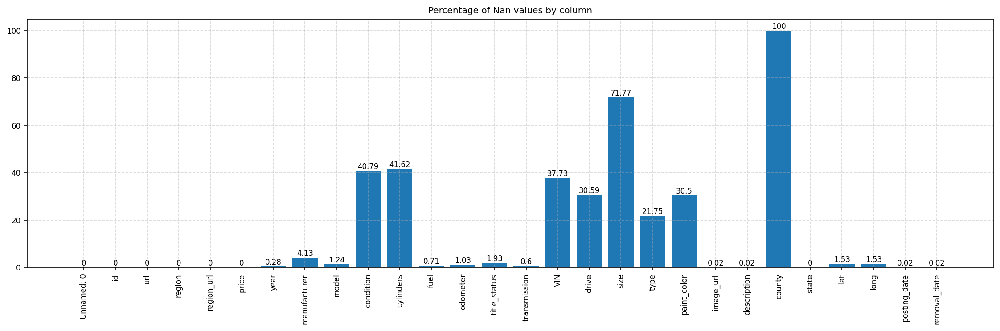

In [13]:
fig, ax = plt.subplots(figsize=[15, 5])
bars = ax.bar(x= df.columns, height=round(na_percentage, 2))
ax.bar_label(bars)
ax.tick_params(axis='x', rotation=90)
ax.tick_params(axis='y')
plt.title("Percentage of Nan values by column")
plt.grid(linestyle="dashed", alpha=0.5)
plt.show()

In [14]:
# drop the country column since it contains all null values
df.drop(columns='county', inplace=True)

In [15]:
# we will also drop the unamed column
df2 = df.drop(columns='Unnamed: 0', inplace=True)

In [16]:
df.head()

,id,url,region,region_url,price,year,manufacturer,model,condition,cylinders,...,size,type,paint_color,image_url,description,state,lat,long,posting_date,removal_date
0,7307679724,https://abilene.craigslist.org/ctd/d/abilene-2...,abilene,https://abilene.craigslist.org,4500,2002.0,bmw,x5,NaN,NaN,...,NaN,NaN,NaN,https://images.craigslist.org/00m0m_iba78h8ty9...,"$4,500 Cash 2002 BMW X5 8 cylinder 4.4L moto...",tx,32.401556,-99.884713,2021-04-16 00:00:00+00:00,2021-05-02 00:00:00+00:00
1,7311833696,https://abilene.craigslist.org/ctd/d/abilene-2...,abilene,https://abilene.craigslist.org,4500,2002.0,bmw,x5,NaN,NaN,...,NaN,NaN,NaN,https://images.craigslist.org/00m0m_iba78h8ty9...,"$4,500 Cash 2002 BMW X5 8 cylinder 4.4L moto...",tx,32.401556,-99.884713,2021-04-24 00:00:00+00:00,2021-04-28 00:00:00+00:00
2,7311441996,https://abilene.craigslist.org/ctd/d/abilene-2...,abilene,https://abilene.craigslist.org,4900,2006.0,toyota,camry,excellent,4 cylinders,...,NaN,sedan,silver,https://images.craigslist.org/00808_5FkOw2aGjA...,2006 TOYOTA CAMRY LE Sedan Ready To Upgrade ...,tx,32.453848,-99.787900,2021-04-23 00:00:00+00:00,2021-05-25 00:00:00+00:00
3,7307680715,https://abilene.craigslist.org/ctd/d/abilene-2...,abilene,https://abilene.craigslist.org,6500,2008.0,ford,expedition,NaN,NaN,...,NaN,NaN,NaN,https://images.craigslist.org/00M0M_i9CoFvVq8o...,$6500.00 2008 Ford Expedition 8 cylinder 5.4L...,tx,32.401556,-99.884713,2021-04-16 00:00:00+00:00,2021-04-26 00:00:00+00:00
4,7311834578,https://abilene.craigslist.org/ctd/d/abilene-2...,abilene,https://abilene.craigslist.org,6500,2008.0,ford,expedition,NaN,NaN,...,NaN,NaN,NaN,https://images.craigslist.org/00M0M_i9CoFvVq8o...,$6500.00 2008 Ford Expedition 8 cylinder 5.4L...,tx,32.401556,-99.884713,2021-04-24 00:00:00+00:00,2021-05-12 00:00:00+00:00


In [17]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 26 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            426880 non-null  int64  
 1   url           426880 non-null  object 
 2   region        426880 non-null  object 
 3   region_url    426880 non-null  object 
 4   price         426880 non-null  int64  
 5   year          425675 non-null  float64
 6   manufacturer  409234 non-null  object 
 7   model         421603 non-null  object 
 8   condition     252776 non-null  object 
 9   cylinders     249202 non-null  object 
 10  fuel          423867 non-null  object 
 11  odometer      422480 non-null  float64
 12  title_status  418638 non-null  object 
 13  transmission  424324 non-null  object 
 14  VIN           265838 non-null  object 
 15  drive         296313 non-null  object 
 16  size          120519 non-null  object 
 17  type          334022 non-null  object 
 18  pain

In [18]:
missing_values_count2 = df.isnull().sum()
print(missing_values_count2)

id                   0
url                  0
region               0
region_url           0
price                0
year              1205
manufacturer     17646
model             5277
condition       174104
cylinders       177678
fuel              3013
odometer          4400
title_status      8242
transmission      2556
VIN             161042
drive           130567
size            306361
type             92858
paint_color     130203
image_url           68
description         70
state                0
lat               6549
long              6549
posting_date        68
removal_date        68
dtype: int64


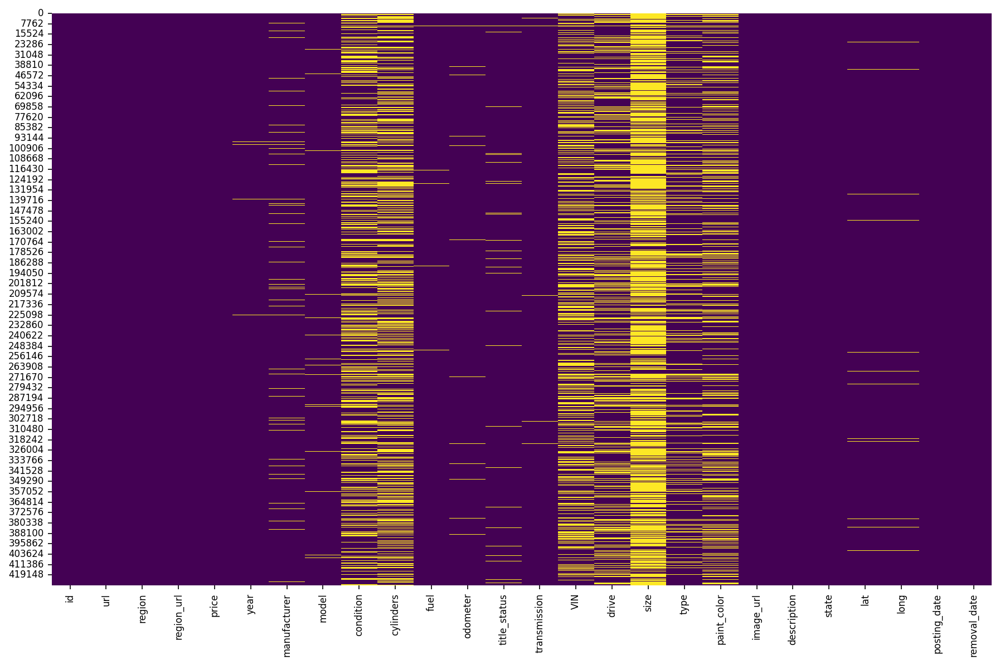

In [19]:
# Set the figure size
plt.figure(figsize=(12, 8))

# Create a heatmap to visualize missing values
sns.heatmap(df.isnull(), cbar=False, cmap='viridis')

# Show th heatmap
plt.show()

The heatmap above displays missing values as yellow lines in the dataset.

There are columns that are not needed for the analysis hence we will drop them but before dropping them, let's examine some of their unique values to understand their importance

In [20]:
!pip install fuzzywuzzy

In [21]:
# Lets check for inconsistency entries in the state and region column
import fuzzywuzzy
from fuzzywuzzy import process
import charset_normalizer

/usr/local/lib/python3.10/dist-packages/fuzzywuzzy/fuzz.py:11: UserWarning: Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning
  warnings.warn('Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning')


In [22]:
regions = df['region'].unique()
regions.sort()
regions

array(['SF bay area', 'abilene', 'akron / canton', 'albany',
       'albuquerque', 'altoona-johnstown', 'amarillo', 'ames',
       'anchorage / mat-su', 'ann arbor', 'annapolis',
       'appleton-oshkosh-FDL', 'asheville', 'ashtabula', 'athens',
       'atlanta', 'auburn', 'augusta', 'austin', 'bakersfield',
       'baltimore', 'baton rouge', 'battle creek',
       'beaumont / port arthur', 'bellingham', 'bemidji', 'bend',
       'billings', 'binghamton', 'birmingham', 'bismarck', 'bloomington',
       'bloomington-normal', 'boise', 'boone', 'boston', 'boulder',
       'bowling green', 'bozeman', 'brainerd', 'brownsville', 'brunswick',
       'buffalo', 'butte', 'cape cod / islands', 'catskills',
       'cedar rapids', 'central NJ', 'central louisiana',
       'central michigan', 'champaign urbana', 'charleston', 'charlotte',
       'charlottesville', 'chattanooga', 'chautauqua', 'chicago', 'chico',
       'chillicothe', 'cincinnati', 'clarksville', 'cleveland',
       'clovis / portal

In [23]:
states = df['state'].unique()
states.sort()
states

array(['ak', 'al', 'ar', 'az', 'ca', 'co', 'ct', 'dc', 'de', 'fl', 'ga',
       'hi', 'ia', 'id', 'il', 'in', 'ks', 'ky', 'la', 'ma', 'md', 'me',
       'mi', 'mn', 'mo', 'ms', 'mt', 'nc', 'nd', 'ne', 'nh', 'nj', 'nm',
       'nv', 'ny', 'oh', 'ok', 'or', 'pa', 'ri', 'sc', 'sd', 'tn', 'tx',
       'ut', 'va', 'vt', 'wa', 'wi', 'wv', 'wy'], dtype=object)

It will be diffucult to work with the states column since it's in initials, we will work with the regions columns instead

In [24]:
df.drop(columns=['region_url', 'url', 'image_url', 'state'], inplace=True)

In [25]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 22 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            426880 non-null  int64  
 1   region        426880 non-null  object 
 2   price         426880 non-null  int64  
 3   year          425675 non-null  float64
 4   manufacturer  409234 non-null  object 
 5   model         421603 non-null  object 
 6   condition     252776 non-null  object 
 7   cylinders     249202 non-null  object 
 8   fuel          423867 non-null  object 
 9   odometer      422480 non-null  float64
 10  title_status  418638 non-null  object 
 11  transmission  424324 non-null  object 
 12  VIN           265838 non-null  object 
 13  drive         296313 non-null  object 
 14  size          120519 non-null  object 
 15  type          334022 non-null  object 
 16  paint_color   296677 non-null  object 
 17  description   426810 non-null  object 
 18  lat 

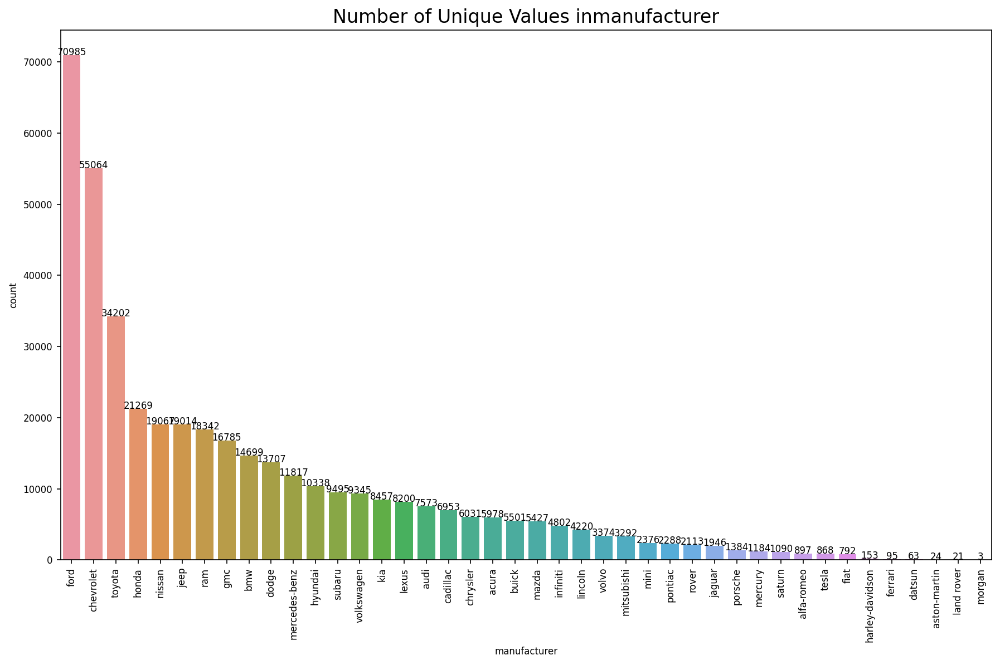

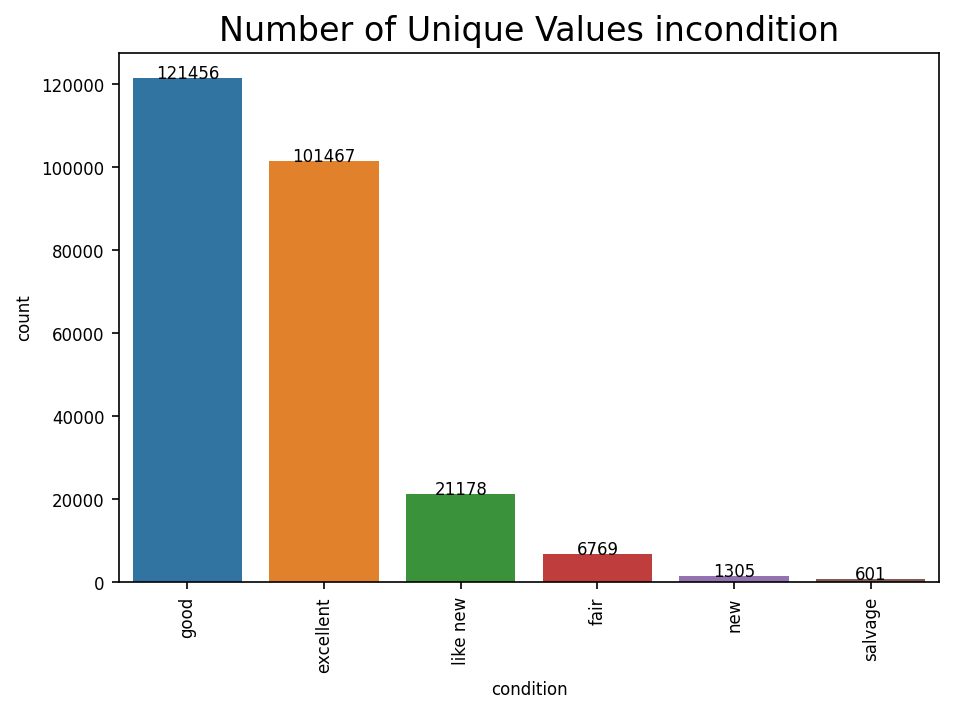

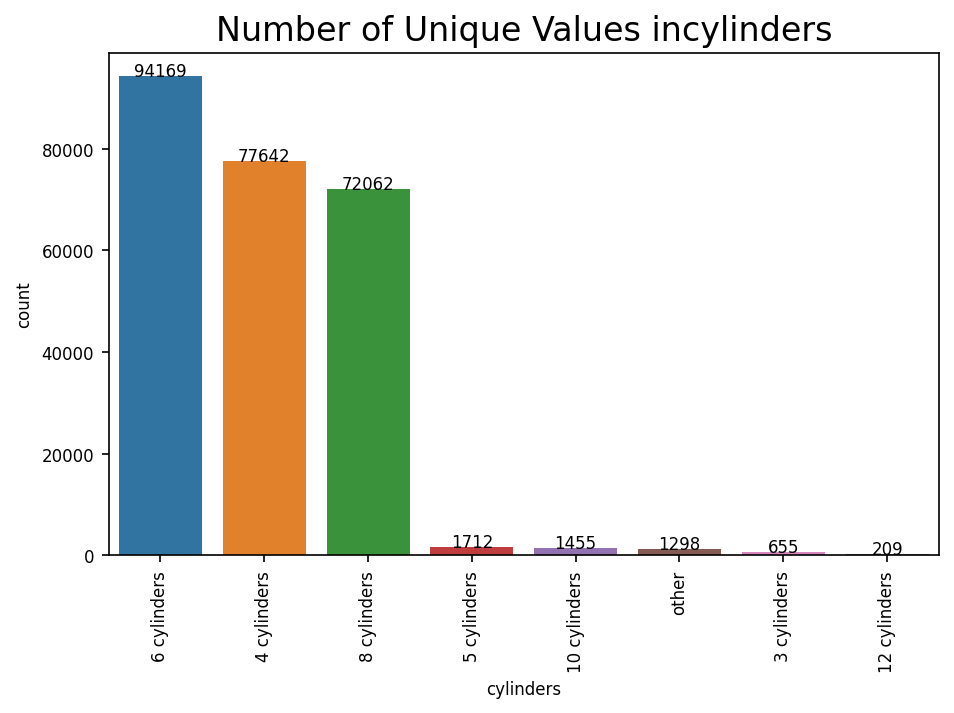

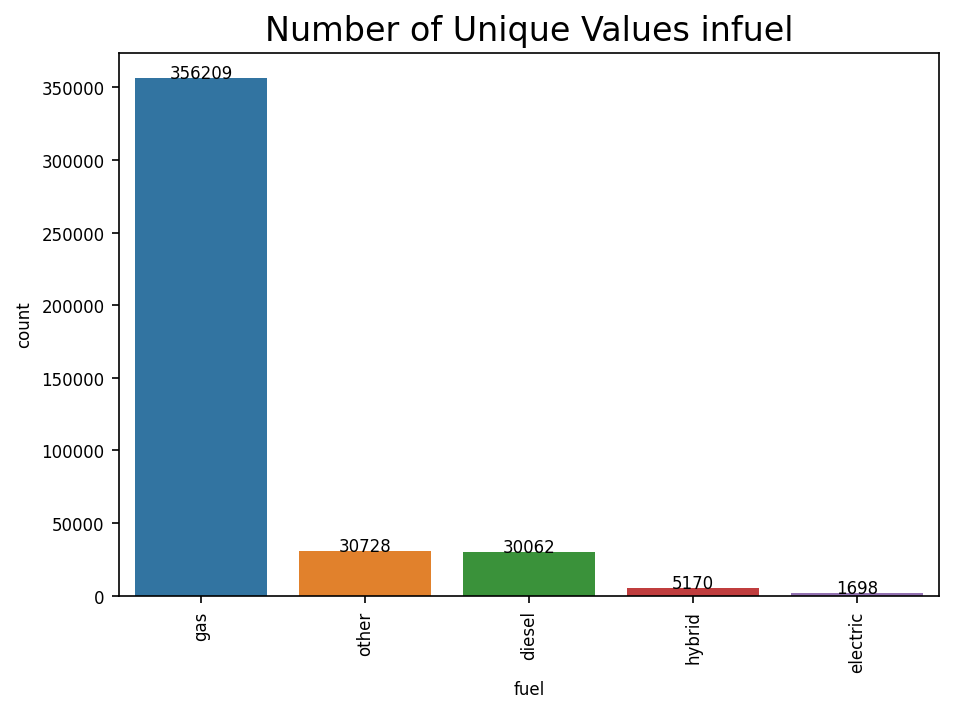

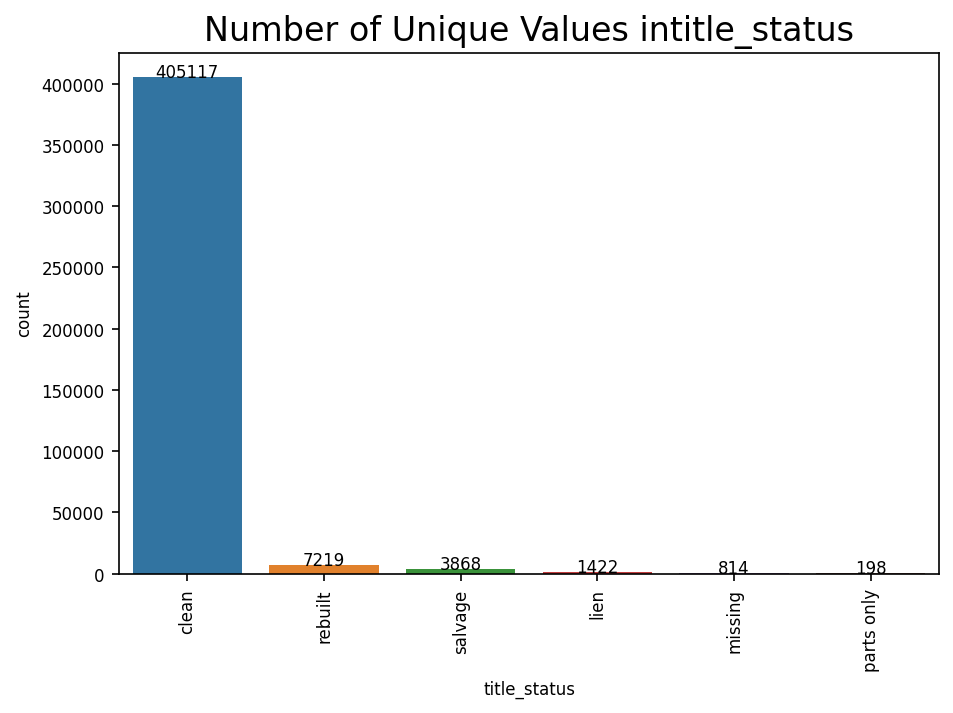

...

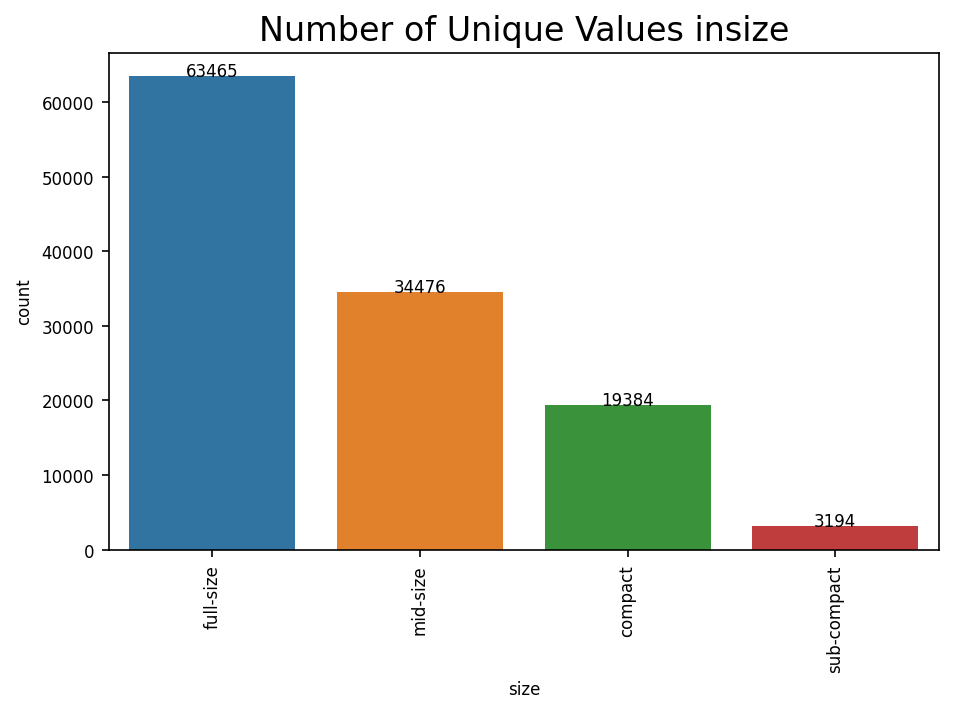

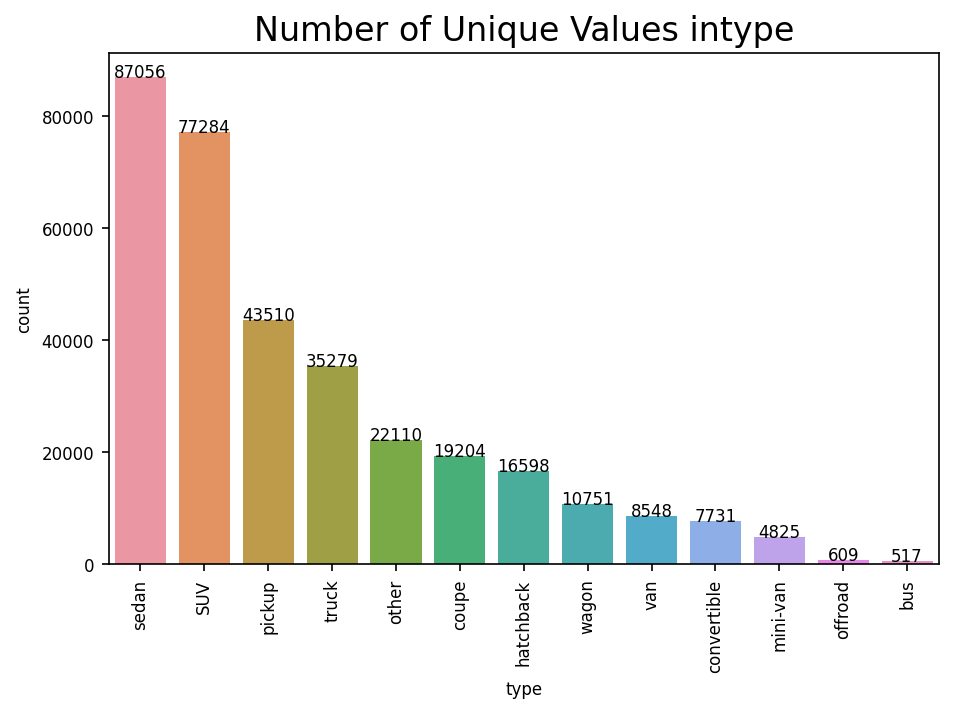

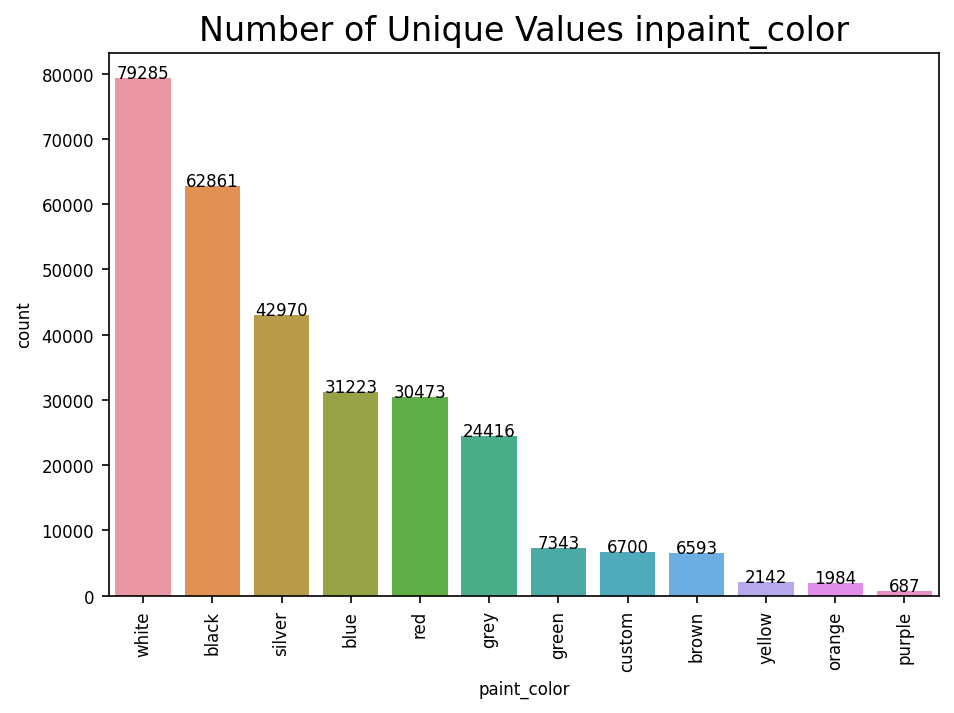

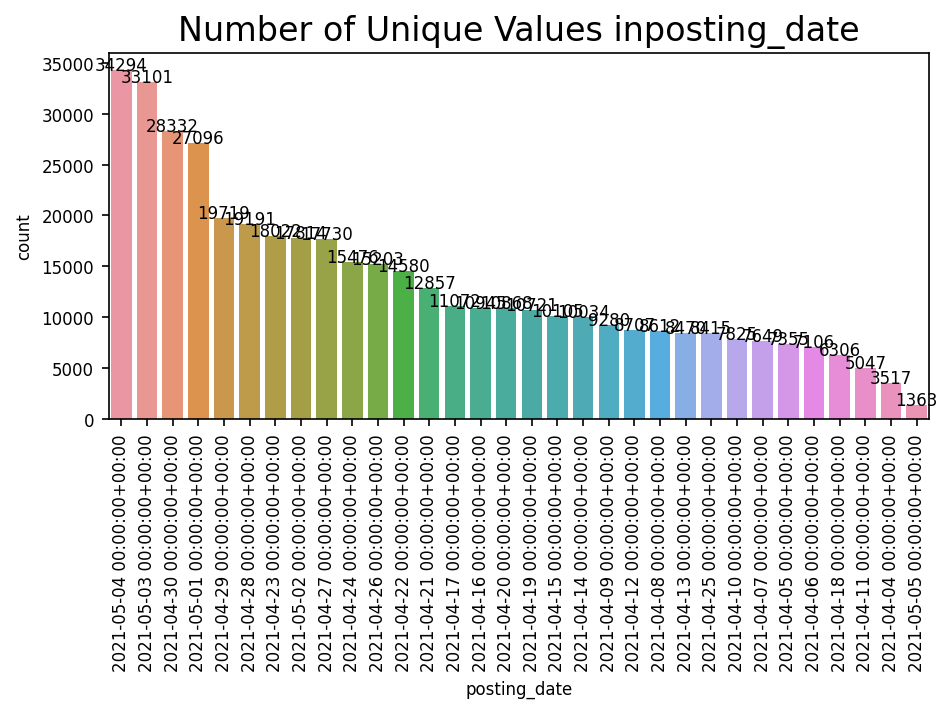

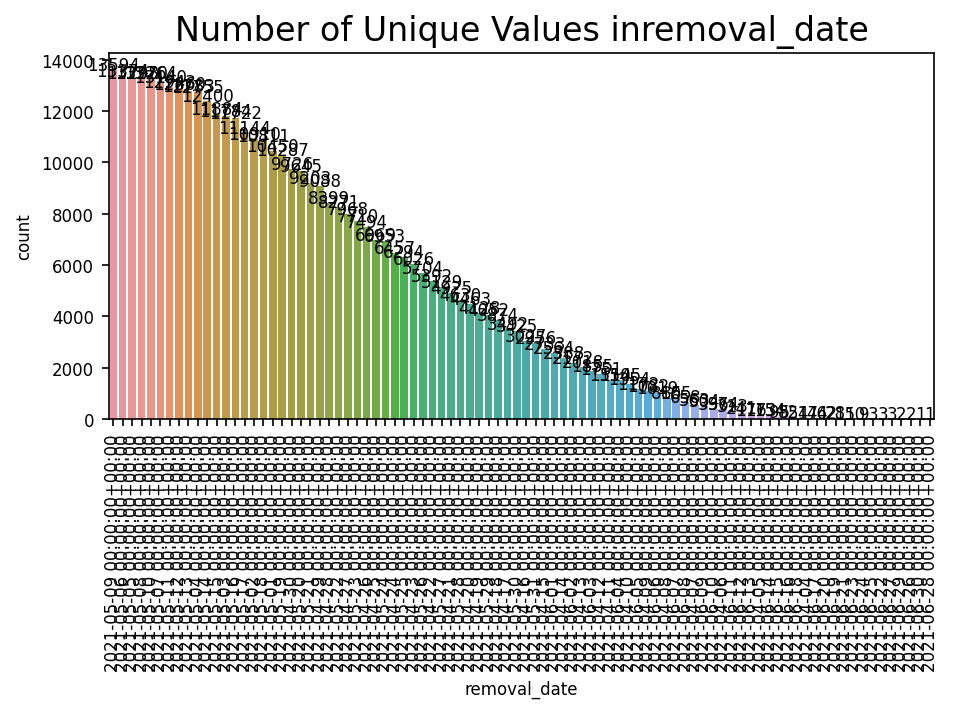

In [26]:
categorical_columns = df.select_dtypes(include='object').columns

max_unique_values = 100

plt.figure(figsize=(12, 8))

# Create a count for each categorical column
for column in categorical_columns:
  if df[column].nunique() < max_unique_values:
    sns.countplot(data=df, x=column, order=df[column].value_counts().index)
    plt.title(f'Number of Unique Values in{column}', fontsize=16)
    plt.xticks(rotation=90)

    # Display the count above each bar
    for p in plt.gca().patches:
      plt.gca().annotate(f'{int(p.get_height())}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='baseline')

    plt.show()

In [27]:
num_col = list(df.select_dtypes(include=["int64", "float64"]).columns)
cat_col = list(df.select_dtypes(include="object").columns)

IndexError: ignored

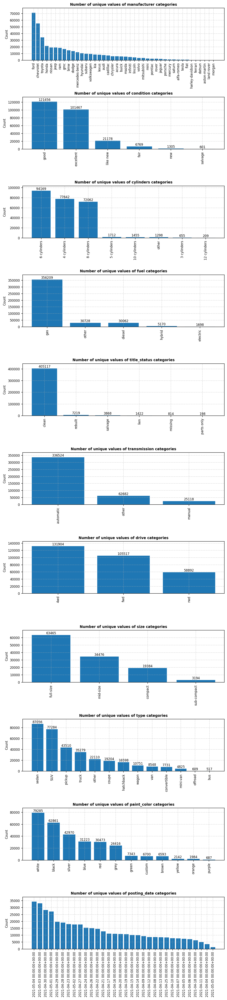

In [29]:
fig, ax = plt.subplots(11, 1, figsize=[8, 35])
index = 0
for column in cat_col:
    if df[column].nunique() < 100:
        # Bar plot:
        bars = ax[index].bar(x=df[column].value_counts().index,
                             height=df[column].value_counts())

        if df[column].nunique() < 15:
             # Numeric label above each bar (only if few labels)
            ax[index].bar_label(bars)
             #Rotation of axis labels for better visuals

        ax[index].tick_params(axis='x', rotation=90, labelsize= 8)
        ax[index].tick_params(axis='y', labelsize= 8)
        ax[index].set_ylabel('Count')

        # Set the subplot title
        ax[index].set_title(f"Number of unique values of {column} categories", fontdict = {"fontsize": 9, "fontweight": "bold"})

        # Add a grid to the subplot
        ax[index].grid(linestyle="dashed", alpha=0.5)

        ax[index].margins(y=0.1)

        # Increment the subplot index
        index += 1

plt.tight_layout()
plt.show()



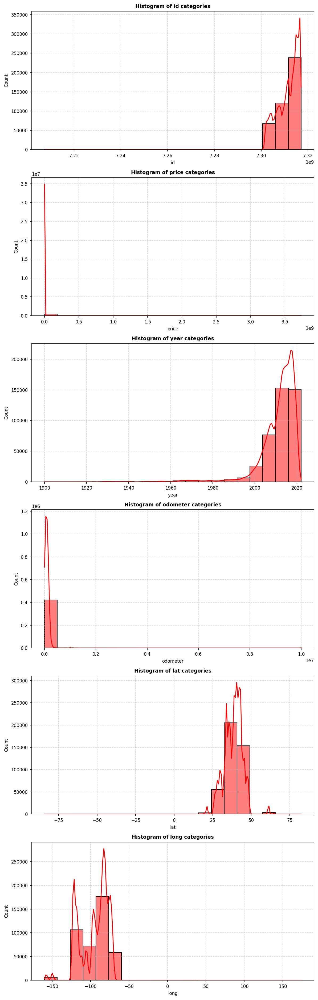

In [31]:
fig, ax = plt.subplots(6, 1, figsize=[8, 25])
index = 0
for index, column in enumerate(num_col):
  # Histplot
  sns.histplot(ax=ax[index], x=df[column], bins=20, kde=True, color='red')

  # Set the subplot title
  ax[index].set_title(f"Histogram of {column} categories", fontdict = {"fontsize": 9, "fontweight": "bold"})

  # Add a grid to the subplot
  ax[index].grid(linestyle="dashed", alpha=0.5)

plt.tight_layout()
plt.show()

Now we have a genral view of our data, let's fill the missing values
We will first fill missing values in title_status, posting_date, and state columns

In [32]:
missing_values_count3 = df.isnull().sum()
print(missing_values_count3)

id                   0
region               0
price                0
year              1205
manufacturer     17646
model             5277
condition       174104
cylinders       177678
fuel              3013
odometer          4400
title_status      8242
transmission      2556
VIN             161042
drive           130567
size            306361
type             92858
paint_color     130203
description         70
lat               6549
long              6549
posting_date        68
removal_date        68
dtype: int64


In [33]:
df['title_status'].unique()

array(['clean', 'missing', 'lien', 'rebuilt', 'salvage', nan,
       'parts only'], dtype=object)

In [34]:
# Filling forward missing values in the title_status, posting_date.
df['title_status'].fillna(method='ffill', inplace=True) # title_status
df['posting_date'].fillna(method='ffill', inplace=True) # Posting_date


Fill drive, type, and paint_color from their values in the description column

In [35]:
df['drive'].unique()

array([nan, 'fwd', '4wd', 'rwd'], dtype=object)

In [36]:
df['type'].unique()

array([nan, 'sedan', 'SUV', 'mini-van', 'pickup', 'truck', 'coupe',
       'hatchback', 'convertible', 'other', 'wagon', 'van', 'offroad',
       'bus'], dtype=object)

In [37]:
import re

# Define regex for drive, type, and paint_color
drive_pattern = r'(4wd|fwd|rwd)'
type_pattern = r'(sedan|Sedan|pickup|SUV|suv|truck|convertible|wagon|hatchback|other)'
paint_color_pattern = r'(blue|BLUE|red|RED|green|GREEN|black|BLACK|white|WHITE|silver|SILVER|gray|GRAY|brown|BROWN|orange|ORANGE|purple|PURPLE|yellow|YELLOW|custom|CUSTOM|grey|GREY|blue|BLUE|turquoise|TURQUOISE|burgundy|BURGUNDY|pink|PINK|beige|BEIGE|purple|PURPLE)'


# Extract drive, type, and paint_color using regex
df['drive'] = df['description'].str.extract(drive_pattern, flags=re.IGNORECASE)
df['type'] = df['description'].str.extract(type_pattern, flags=re.IGNORECASE)
df['paint_color'] = df['description'].str.extract(paint_color_pattern, flags=re.IGNORECASE)

# Fill the missing values in the respective columns
df['drive'].fillna('', inplace=True)
df['type'].fillna('', inplace=True)
df['paint_color'].fillna('', inplace=True)

In [38]:
df['manufacturer'].fillna(df['manufacturer'].mode()[0], inplace=True)
df['model'].fillna(df['model'].mode()[0], inplace=True)
df['fuel'].fillna(df['fuel'].mode()[0], inplace=True)
df['transmission'].fillna(df['transmission'].mode()[0], inplace=True)
df['type'].fillna(df['type'].mode()[0], inplace=True)


In [39]:
df['description'].unique()

array(['$4,500 Cash  2002 BMW X5  8 cylinder 4.4L motor  Automatic transmission  184k miles Leather seats  Cold Ac and great heater This car runs great, has a new water pump! Leather seat are in good condition. Has some small issues with the interior.￼￼Does have some small blemishes. This is a great car, come by and take it for a test drive! Let’s make a deal!  Call or text BMW  512-653-0636 Stop by  LNC Auto Sales  1842 N First st Abilene Tx 79603',
       "2006 TOYOTA CAMRY LE Sedan   Ready To Upgrade Your Ride Today? We Make It Fast & Easy!Call (or text) ☏ (325) 725−8154  Richard Roberts Motors 134 N. Clack Street, Abilene, TX 79603Copy & Paste the URL belowto view more information!http://richardrobertsmotors.com   \t\t\tYear : 2006\t\t\t\tMake : TOYOTA\t\t\t\tModel : CAMRY\t\t\t\tTrim : LE\t\t\t\t   Mileage : 184,930 miles\t\t\t\tTransmission : Automatic\t\t\t\tExterior Color : SILVER\t\t\t\tInterior Color : GRAY\t\t\t\tSeries : LE Sedan\t\t\t\tDrivetrain : FWD\t\t\t\tCondition : E

Year and odometer column

In [40]:
df['year'].fillna(df['year'].median(), inplace=True)
df['odometer'].fillna(df['odometer'].median(), inplace=True)

In [41]:
df['lat'].fillna(df['lat'].median(), inplace=True)
df['long'].fillna(df['long'].median(), inplace=True)


In [42]:
df.isnull().sum()

id                   0
region               0
price                0
year                 0
manufacturer         0
model                0
condition       174104
cylinders       177678
fuel                 0
odometer             0
title_status         0
transmission         0
VIN             161042
drive                0
size            306361
type                 0
paint_color          0
description         70
lat                  0
long                 0
posting_date         0
removal_date        68
dtype: int64

In [43]:
df['removal_date'].fillna(method='ffill', inplace=True) # Posting_date

In [44]:
df['condition'].unique()

array([nan, 'excellent', 'good', 'like new', 'fair', 'new', 'salvage'],
      dtype=object)

In [45]:
import plotly.express as px

# Count the occurrences of each unique value
condition_counts = df['condition'].value_counts()

# Create a DF with the counts and the corresponding condition values
condition_df = pd.DataFrame({'Condition': condition_counts.index, 'Count': condition_counts.values})

# create a bar chart
fig = px.bar(condition_df, x='Condition', y='Count', title='Count of Vehicles by Condition')
fig.show()

Since most cars are in good condition we will fill the condition column with the most frequent attribute

In [46]:
df['condition'].fillna(df['condition'].mode()[0], inplace=True)

In [47]:
df['cylinders'].unique()

array([nan, '4 cylinders', '6 cylinders', '8 cylinders', 'other',
       '5 cylinders', '10 cylinders', '3 cylinders', '12 cylinders'],
      dtype=object)

In [48]:
# Count the occurrences of each unique value
cylinders_counts = df['cylinders'].value_counts()

# Create a DF with the counts and the corresponding condition values
cylinders_df = pd.DataFrame({'Cylinders': cylinders_counts.index, 'Count': cylinders_counts.values})

# create a bar chart
fig = px.bar(cylinders_df, x='Cylinders', y='Count', title='Count of Vehicles by Cylinders')
fig.show()

In [49]:
df['size'].unique()

array([nan, 'full-size', 'sub-compact', 'compact', 'mid-size'],
      dtype=object)

In [50]:
# Define regex for drive, type, and paint_color
cylinders_pattern = r'(4 cylinders|6 cylinders|8 cylinders|5 cylinders|10 cylinders|3 cylinders|12 cylinders)'
size_pattern = r'(full-size|sub-compact|compact|mid-size)'


# Extract drive, type, and paint_color using regex
df['cylinders'] = df['description'].str.extract(cylinders_pattern, flags=re.IGNORECASE)
df['size'] = df['description'].str.extract(size_pattern, flags=re.IGNORECASE)

# Fill the missing values in the respective columns
df['cylinders'].fillna('', inplace=True)
df['size'].fillna('', inplace=True)

In [51]:
df.isnull().sum()

id                   0
region               0
price                0
year                 0
manufacturer         0
model                0
condition            0
cylinders            0
fuel                 0
odometer             0
title_status         0
transmission         0
VIN             161042
drive                0
size                 0
type                 0
paint_color          0
description         70
lat                  0
long                 0
posting_date         0
removal_date         0
dtype: int64

In [52]:
df['VIN'].unique()

array([nan, '4T4BF1FK1ER378075', '5YFBURHE5GP531969', ...,
       '3FAHP0GA8CR440815', '1GCVKREC1FZ443253', '1FTPX14526FB67374'],
      dtype=object)

In [53]:
df.describe()

,id,price,year,odometer,lat,long
count,4.268800e+05,4.268800e+05,426880.000000,4.268800e+05,426880.000000,426880.000000
mean,7.311487e+09,7.519903e+04,2011.240173,9.791454e+04,38.504007,-94.651702
std,4.473170e+06,1.218228e+07,9.439234,2.127801e+05,5.797112,18.240566
min,7.207408e+09,0.000000e+00,1900.000000,0.000000e+00,-84.122245,-159.827728
25%,7.308143e+09,5.900000e+03,2008.000000,3.813000e+04,34.757016,-111.907973
50%,7.312621e+09,1.395000e+04,2013.000000,8.554800e+04,39.150100,-88.432600
75%,7.315254e+09,2.648575e+04,2017.000000,1.330000e+05,42.350000,-81.030000
max,7.317101e+09,3.736929e+09,2022.000000,1.000000e+07,82.390818,173.885502


In [54]:
# Lets drop missing values in the description column
df.dropna(subset=['description'], inplace=True)

In [55]:
df.isnull().sum()

id                   0
region               0
price                0
year                 0
manufacturer         0
model                0
condition            0
cylinders            0
fuel                 0
odometer             0
title_status         0
transmission         0
VIN             160973
drive                0
size                 0
type                 0
paint_color          0
description          0
lat                  0
long                 0
posting_date         0
removal_date         0
dtype: int64

Hurray we've cleaned our data. Lets deal with anomalies in the price, odometer year column

The max and min values excessively large values for price(3.73+09) and odometer(1E+07) and low values for year(around 1900). We will need to perfomr outlier treatment to identify which of these values may be due to human error and can be corrected, and which should be directly discarded. Let's create some figures to identify them

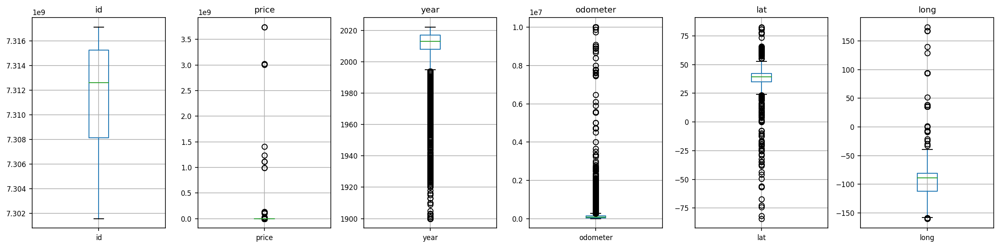

In [56]:
num_col = list(df.select_dtypes(include=['int64','float64']).columns)

fig, axes = plt.subplots(nrows=1, ncols=len(num_col), figsize=(16, 4))

for i, col in enumerate(num_col):
  df.boxplot(column=col, ax=axes[i])
  axes[i].set_title(col)

plt.show()

In [57]:
df.shape

(426810, 22)

Price
We have extremely skewed data points due to the improper actions of users.

In [58]:
df.isnull().sum()

id                   0
region               0
price                0
year                 0
manufacturer         0
model                0
condition            0
cylinders            0
fuel                 0
odometer             0
title_status         0
transmission         0
VIN             160973
drive                0
size                 0
type                 0
paint_color          0
description          0
lat                  0
long                 0
posting_date         0
removal_date         0
dtype: int64

In [59]:
df[df['price']>1E6].head(10)

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,...,VIN,drive,size,type,paint_color,description,lat,long,posting_date,removal_date
16,7301838920,abilene,1234567,1955.0,chevrolet,f-150,good,,other,99999.0,...,NaN,,,,RED,THE 38TH ANNUAL NATIONALLY ADVERTISED BELTON S...,31.052169,-97.498512,2021-04-04 00:00:00+00:00,2021-05-10 00:00:00+00:00
17,7303378226,abilene,1234567,1955.0,chevrolet,f-150,good,,other,99999.0,...,NaN,,,,RED,THE 38TH ANNUAL NATIONALLY ADVERTISED BELTON S...,31.052169,-97.498512,2021-04-07 00:00:00+00:00,2021-04-08 00:00:00+00:00
18,7304059291,abilene,1234567,1955.0,chevrolet,f-150,good,,other,99999.0,...,NaN,,,,RED,THE 38TH ANNUAL NATIONALLY ADVERTISED BELTON S...,31.052169,-97.498512,2021-04-09 00:00:00+00:00,2021-04-29 00:00:00+00:00
1202,7302112231,akron / canton,12345678,2019.0,chevrolet,f-150,good,,gas,100000.0,...,00000000000000000,,,truck,,"WE HAVE MOVED TO 2517 FULTON DRIVE NW CANTON, ...",40.846500,-81.440800,2021-04-05 00:00:00+00:00,2021-04-28 00:00:00+00:00
1203,7302113550,akron / canton,12345678,2019.0,chevrolet,f-150,good,,gas,100000.0,...,00000000000000000,,,truck,,"WE HAVE MOVED TO 2517 FULTON DRIVE NW CANTON, ...",40.846500,-81.440800,2021-04-05 00:00:00+00:00,2021-04-25 00:00:00+00:00
1204,7316737396,akron / canton,12345678,2019.0,chevrolet,f-150,good,,gas,100000.0,...,00000000000000000,,,truck,,"WE HAVE MOVED TO 2517 FULTON DRIVE NW CANTON, ...",40.846500,-81.440800,2021-05-04 00:00:00+00:00,2021-05-29 00:00:00+00:00
1205,7316737760,akron / canton,12345678,2019.0,chevrolet,f-150,good,,gas,100000.0,...,00000000000000000,,,truck,,"WE HAVE MOVED TO 2517 FULTON DRIVE NW CANTON, ...",40.846500,-81.440800,2021-05-04 00:00:00+00:00,2021-05-23 00:00:00+00:00
2205,7302369138,akron / canton,123456789,1965.0,chevrolet,project,good,,gas,100000.0,...,NaN,,,,,"1965 Chevy Nova $10,000 FIRM. New floors, new ...",41.019700,-81.621200,2021-04-05 00:00:00+00:00,2021-04-18 00:00:00+00:00
9552,7314563134,altoona-johnstown,3226714,2002.0,ford,any and all,fair,,diesel,1234.0,...,NaN,,,truck,,Buying Junk/Unwanted/Crashed Vehicles Cars-tru...,40.480100,-78.726300,2021-04-29 00:00:00+00:00,2021-06-04 00:00:00+00:00
13616,7307876060,ann arbor,1234567,2010.0,lincoln,mkt ecoboost,like new,,gas,85653.0,...,2LMHJ5AT1ABJ50124,,,,GREEN,ON THE LOT AND FOR SALE AT BOWLING GREEN LINCO...,41.381500,-83.650700,2021-04-16 00:00:00+00:00,2021-04-22 00:00:00+00:00


In [60]:
# We have values that don't make sense like 123456789 and other correspond to decimal point
df.loc[2205]

id                                                     7302369138
region                                             akron / canton
price                                                   123456789
year                                                       1965.0
manufacturer                                            chevrolet
model                                                     project
condition                                                    good
cylinders                                                        
fuel                                                          gas
odometer                                                 100000.0
title_status                                                clean
transmission                                            automatic
VIN                                                           NaN
drive                                                            
size                                                             
type      

In [61]:
df['price'].quantile(0.08)

1.0

In [62]:
df[df['price']<10].head(10)

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,...,VIN,drive,size,type,paint_color,description,lat,long,posting_date,removal_date
13,7303347398,abilene,0,2018.0,ford,peterbilt 579,good,,diesel,1.0,...,NaN,,,,GRAY,"◄ PRICES STARTING AT $57,500 ($57,500 and up, ...",32.444650,-99.725647,2021-04-07 00:00:00+00:00,2021-04-19 00:00:00+00:00
158,7316929445,abilene,0,2011.0,ford,2016 F450-F750,good,,diesel,222000.0,...,NaN,4WD,COMPACT,TRUCK,red,GO TO WWW.BUCKETTRUCKSALES.COM FOR PRICING AND...,29.383820,-98.325577,2021-05-04 00:00:00+00:00,2021-05-13 00:00:00+00:00
159,7316891761,abilene,0,2020.0,dodge,durango r/t,good,,gas,2108.0,...,NaN,,,,,Pre-Owned 2020 Dodge Durango R/T With Navigati...,32.745100,-100.917500,2021-05-04 00:00:00+00:00,2021-05-15 00:00:00+00:00
163,7309763443,abilene,0,2011.0,kia,forte,good,,gas,149931.0,...,KNAFU4A27B5886536,FWD,,other,White,Stanley Ford Sweetwater address: 603 Southw...,32.447591,-100.408954,2021-04-20 00:00:00+00:00,2021-04-30 00:00:00+00:00
167,7316697721,abilene,0,2014.0,ford,expedition,good,,gas,103958.0,...,1FMJU1F56EEF24289,RWD,Full-Size,other,White,Stanley Ford Sweetwater address: 603 Southw...,32.447591,-100.408954,2021-05-04 00:00:00+00:00,2021-05-19 00:00:00+00:00
171,7302555572,abilene,0,2015.0,kia,optima,good,,gas,35140.0,...,5XXGM4A72FG441657,FWD,mid-size,other,Blue,Stanley Ford Sweetwater address: 603 Southw...,32.447591,-100.408954,2021-04-06 00:00:00+00:00,2021-04-30 00:00:00+00:00
173,7307670705,abilene,0,2015.0,toyota,camry,good,,gas,106069.0,...,4T1BF1FKXFU010988,FWD,Mid-size,,Black,Stanley Ford Sweetwater address: 603 Southw...,32.447591,-100.408954,2021-04-16 00:00:00+00:00,2021-05-02 00:00:00+00:00
192,7302020815,abilene,0,2017.0,tesla,model 3,good,,diesel,0.0,...,TEST9292020,RWD,,Sedan,Green,2017 *Tesla* *Model 3* Long Range RWD SedanCal...,41.608569,-71.073548,2021-04-05 00:00:00+00:00,2021-05-10 00:00:00+00:00
706,7303027389,akron / canton,0,1990.0,ford,cars suvs trucks,good,,gas,1234.0,...,NaN,,,,RED,Negotiate Your Used Car Price with a Pre-Purch...,41.095484,-81.450629,2021-04-07 00:00:00+00:00,2021-04-15 00:00:00+00:00
777,7303661574,akron / canton,0,2007.0,ford,f-150,good,,other,119453.0,...,1FTPX14VX7FA82588,4WD,,Truck,red,"2007 Ford F-150 F150 F 150 4WD Supercab 133"" X...",41.041256,-81.607193,2021-04-08 00:00:00+00:00,2021-04-22 00:00:00+00:00


These prices are logically incorrect. Let's proceed and remove the data that do not need them

In [63]:
min_price = df[df['price'] < 10].index
max_price = df[df['price'] > 1000000].index

In [64]:
df.drop(index=min_price, axis=0, errors='ignore', inplace=True)
df.drop(index=max_price, axis=0, errors='ignore', inplace=True)

Let's perform a more outlier analysis using IQR, to avoid introducing bias, we will remove outliers while considering year of manufacture as a moving element. This is  because the median and IQR change substantially w.r.t the car's year of manufacture

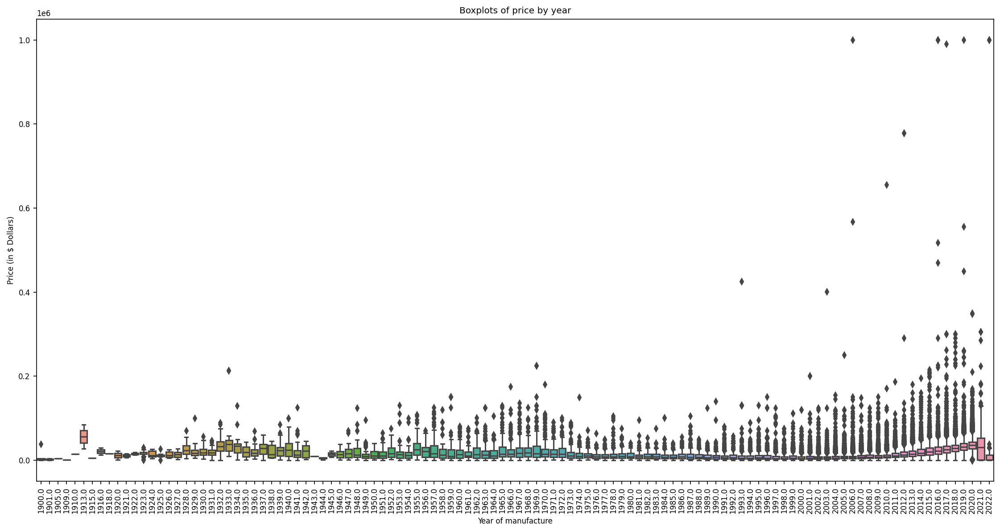

In [65]:
plt.figure(figsize=(15, 8))
sns.boxplot(x='year', y='price', data=df)
plt.tick_params(axis='x', rotation=90)
plt.title('Boxplots of price by year')
plt.xlabel('Year of manufacture')
plt.xlabel('Year of manufacture')
plt.ylabel('Price (in $ Dollars)')
plt.show()

In [66]:
# A more interactive plots
fig = px.box(df, x='year', y='price')

fig.update_layout(
    title = 'Boxplots of price by year',
    xaxis_title='Year of manufacture',
    yaxis_title='Price (in $ Dollars)',
    xaxis=dict(tickangle=90),
    showlegend=False
)
fig.show()

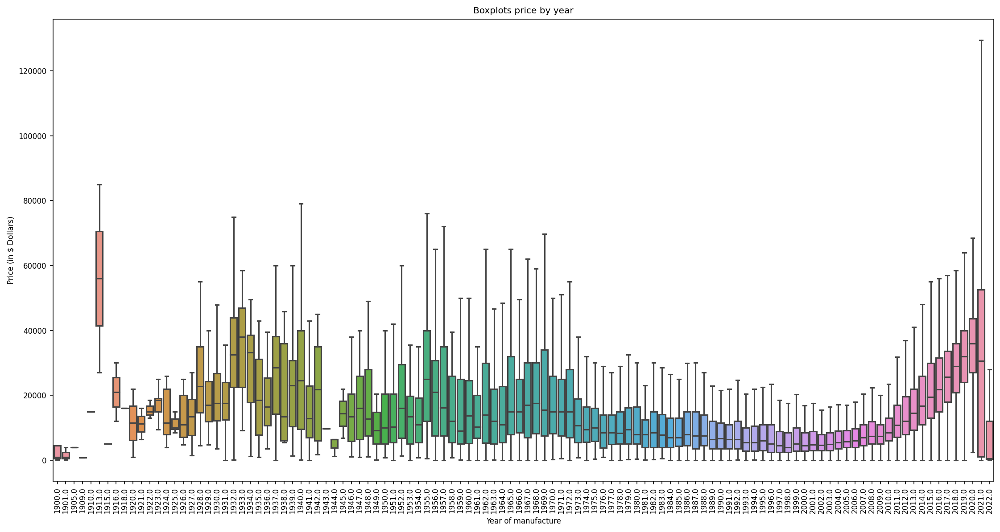

In [67]:
plt.figure(figsize=(15, 8))
sns.boxplot(x='year', y='price', data=df, showfliers=False)
plt.tick_params(axis='x', rotation=90)
plt.title('Boxplots price by year')
plt.xlabel('Year of manufacture')
plt.ylabel('Price (in $ Dollars)')
plt.show()

Lets remove outliers for each year

In [68]:
for year in sorted(df['year'].unique()):
  q1 = df[df['year'] == year]['price'].quantile(0.25)
  q3 = df[df['year'] == year]['price'].quantile(0.75)
  IQR = q3 - q1
  lower_limit = q1 - 1*5*IQR
  upper_limit = q3 + 1*5*IQR
  lower_indexes = df[(df['year'] == year) & (df['price'] < lower_limit)].index
  upper_indexes = df[(df['year'] == year) & (df['price'] > upper_limit)].index
  df.drop(index=lower_indexes, axis=0, errors='ignore', inplace=True)
  df.drop(index=upper_indexes, axis=0, errors='ignore', inplace=True)

**Odometer**

We will examine extremme values and remove all cars that have more than 300,000 miles(482, 000km) and all cars that have fwer than 500 miles(~800km) and are not categorized as new.

In [69]:
low_odometer = df[(df['odometer'] < 500) & (df['condition'] != 'new')].index
high_odometer = df[df['odometer'] > 300000].index

In [70]:
df.drop(index=low_odometer, axis=0, errors='ignore', inplace=True)
df.drop(index=high_odometer, axis=0, errors='ignore', inplace=True)

We proceed to remove outlier values using IQR but this time considering the odometer values for each year

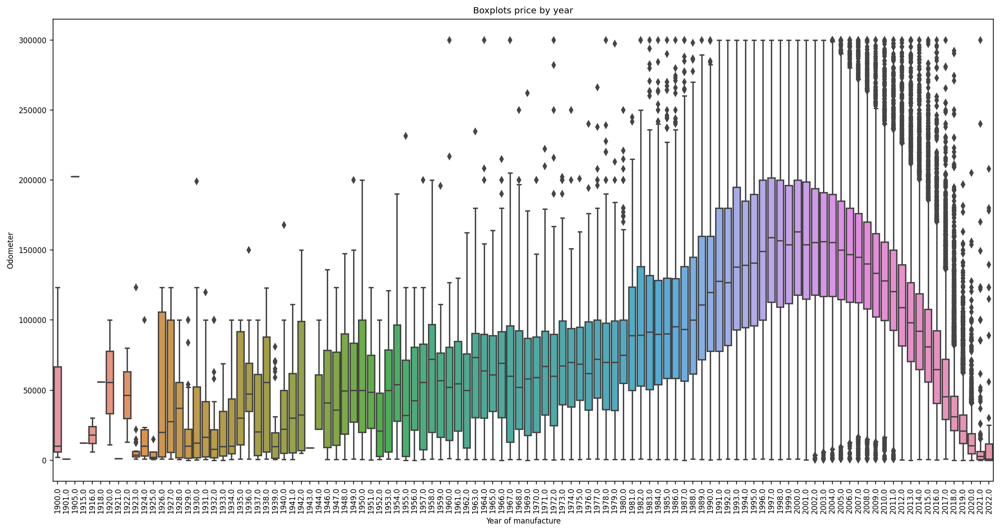

In [71]:
plt.figure(figsize=(15, 8))
sns.boxplot(x='year', y='odometer', data=df)
plt.tick_params(axis='x', rotation=90)
plt.title('Boxplots price by year')
plt.xlabel('Year of manufacture')
plt.ylabel('Odometer')
plt.show()

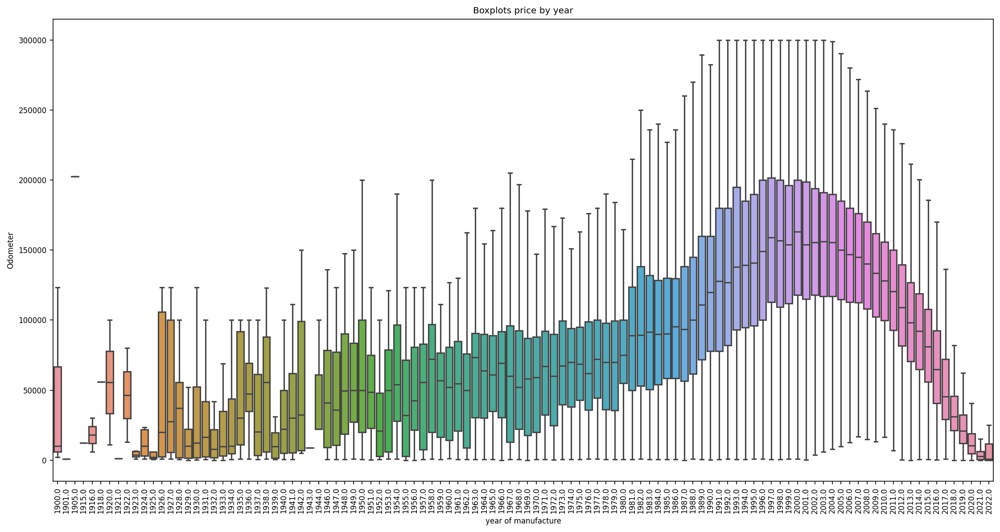

In [72]:
# With no outliers
plt.figure(figsize=(15, 8))
sns.boxplot(x='year', y='odometer', data=df, showfliers=False)
plt.tick_params(axis='x', rotation=90)
plt.title('Boxplots price by year')
plt.xlabel('year of manufacture')
plt.ylabel('Odometer')
plt.show()

In [73]:
for year in sorted(df['year'].unique()):
  q1 = df[df['year'] == year]['odometer'].quantile(0.25)
  q3 = df[df['year'] == year]['odometer'].quantile(0.75)
  IQR = q3 - q1
  lower_limit = q1 - 1*5*IQR
  upper_limit = q3 + 1*5*IQR
  lower_indexes = df[(df['year'] == year) & (df['odometer'] < lower_limit)].index
  upper_indexes = df[(df['year'] == year) & (df['odometer'] > upper_limit)].index

  df.drop(index=lower_indexes, axis=0, errors='ignore', inplace=True)
  df.drop(index=upper_indexes, axis=0, errors='ignore', inplace=True)

**Year**
We will remove outliers for the year variable and we will amke several considerations

1. we will consider as the lower limit, cars starting from 1908
2. As the upper limit, we will eliminate 2022 because it has very few data points.

In [74]:
print('2020:', df[df['year'] == 2020].shape)
print('2021:', df[df['year'] == 2021].shape)
print('2022:', df[df['year'] == 2022].shape)

2020: (16897, 22)
2021: (1016, 22)
2022: (38, 22)


In [75]:
low_year = df[df['year'] < 1908].index
high_year = df[df['year'] > 2021].index

In [76]:
df.drop(index=low_year, axis=0, errors='ignore', inplace=True)
df.drop(index=high_year, axis=0, errors='ignore', inplace=True)

In [77]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 380822 entries, 0 to 426879
Data columns (total 22 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            380822 non-null  int64  
 1   region        380822 non-null  object 
 2   price         380822 non-null  int64  
 3   year          380822 non-null  float64
 4   manufacturer  380822 non-null  object 
 5   model         380822 non-null  object 
 6   condition     380822 non-null  object 
 7   cylinders     380822 non-null  object 
 8   fuel          380822 non-null  object 
 9   odometer      380822 non-null  float64
 10  title_status  380822 non-null  object 
 11  transmission  380822 non-null  object 
 12  VIN           236340 non-null  object 
 13  drive         380822 non-null  object 
 14  size          380822 non-null  object 
 15  type          380822 non-null  object 
 16  paint_color   380822 non-null  object 
 17  description   380822 non-null  object 
 18  lat 

**Duplicate values**
ThIN column which must necessarily be unique.

In [78]:
df['VIN'].value_counts()

1FMJU1JT1HEA52352    261
3C6JR6DT3KG560649    235
1FTER1EH1LLA36301    231
5TFTX4CN3EX042751    227
1GCHTCE37G1186784    214
                    ... 
1FTYR1YM0KKA41984      1
1FBAX2CM8KKA15562      1
1FTER4FH3KLA87748      1
3FA6P0SU9KR252196      1
1FTPX14526FB67374      1
Name: VIN, Length: 103489, dtype: int64

In [79]:
df[df['VIN'] == '1FMJU1JT1HEA52352'].head()

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,...,VIN,drive,size,type,paint_color,description,lat,long,posting_date,removal_date
499,7311883703,akron / canton,29590,2017.0,ford,expedition xlt sport,good,,gas,70760.0,...,1FMJU1JT1HEA52352,4wd,,suv,custom,Carvana is the safer way to buy a car During t...,41.08,-81.52,2021-04-24 00:00:00+00:00,2021-05-06 00:00:00+00:00
2675,7311902781,albany,29590,2017.0,ford,expedition xlt sport,good,,gas,70760.0,...,1FMJU1JT1HEA52352,4wd,,suv,custom,Carvana is the safer way to buy a car During t...,42.66,-73.79,2021-04-24 00:00:00+00:00,2021-05-08 00:00:00+00:00
4820,7311784092,albany,29590,2017.0,ford,expedition xlt sport,good,,gas,70760.0,...,1FMJU1JT1HEA52352,4wd,,suv,custom,Carvana is the safer way to buy a car During t...,31.57,-84.17,2021-04-24 00:00:00+00:00,2021-04-26 00:00:00+00:00
5890,7311889753,albuquerque,29590,2017.0,ford,expedition xlt sport,good,,gas,70760.0,...,1FMJU1JT1HEA52352,4wd,,suv,custom,Carvana is the safer way to buy a car During t...,35.11,-106.62,2021-04-24 00:00:00+00:00,2021-04-30 00:00:00+00:00
8515,7311883909,lehigh valley,29590,2017.0,ford,expedition xlt sport,good,,gas,70760.0,...,1FMJU1JT1HEA52352,4wd,,suv,custom,Carvana is the safer way to buy a car During t...,40.68,-75.22,2021-04-24 00:00:00+00:00,2021-05-21 00:00:00+00:00


This doesn't imply that the car has been sold 261 times because the seller posed the same ad in each fo the regions or states to maximize visibility.

We will use the manufacturer, model, price, year and VIN as reference values

In [80]:
df.drop_duplicates(subset=['price', 'year', 'manufacturer', 'model', 'VIN'], keep='first', inplace=True)

In [81]:
df.isna().sum() / df.shape[0] * 100

id               0.00000
region           0.00000
price            0.00000
year             0.00000
manufacturer     0.00000
model            0.00000
condition        0.00000
cylinders        0.00000
fuel             0.00000
odometer         0.00000
title_status     0.00000
transmission     0.00000
VIN             48.78112
drive            0.00000
size             0.00000
type             0.00000
paint_color      0.00000
description      0.00000
lat              0.00000
long             0.00000
posting_date     0.00000
removal_date     0.00000
dtype: float64

In [82]:
df['title_status'].unique()

array(['clean', 'lien', 'missing', 'rebuilt', 'salvage', 'parts only'],
      dtype=object)

In [83]:
# Let's set aside the data for cars whose condition is salvage or whose legal status is not entirely clean

salvage_cars = df[df['condition'] == 'salvage'].index


In [84]:
unclean_cars = df[df['title_status'] != 'clean'].index

In [85]:
df.dropna(inplace=True)

In [86]:
df.isna().sum()

id              0
region          0
price           0
year            0
manufacturer    0
model           0
condition       0
cylinders       0
fuel            0
odometer        0
title_status    0
transmission    0
VIN             0
drive           0
size            0
type            0
paint_color     0
description     0
lat             0
long            0
posting_date    0
removal_date    0
dtype: int64

In [87]:
# The remaining features are:
df.columns

Index(['id', 'region', 'price', 'year', 'manufacturer', 'model', 'condition',
       'cylinders', 'fuel', 'odometer', 'title_status', 'transmission', 'VIN',
       'drive', 'size', 'type', 'paint_color', 'description', 'lat', 'long',
       'posting_date', 'removal_date'],
      dtype='object')

In [88]:
df['odometer'] = df['odometer'].astype('int64')
df['year'] = df['year'].astype('int64')


In [89]:
print(df['posting_date'].head())

8     2021-04-18 00:00:00+00:00
10    2021-04-12 00:00:00+00:00
19    2021-04-26 00:00:00+00:00
20    2021-04-26 00:00:00+00:00
21    2021-04-26 00:00:00+00:00
Name: posting_date, dtype: object


In [90]:
df['posting_date'] = pd.to_datetime(df['posting_date'], errors='coerce')

In [91]:
df['posting_date'].dtype

datetime64[ns, UTC]

In [92]:
df['removal_date'] = pd.to_datetime(df['removal_date'], errors='coerce')

## Exploratory Data Analysis
**Feature Relations**
Let's proceed to check for possible correlations between variables. We are interested in those variables related to price of the vehicle

In [93]:
df.corr(numeric_only=True)

,id,price,year,odometer,lat,long
id,1.000000,-0.031269,-0.030235,0.004184,-0.073094,-0.142104
price,-0.031269,1.000000,0.389917,-0.500343,0.017445,-0.132006
year,-0.030235,0.389917,1.000000,-0.477094,0.002393,-0.063301
odometer,0.004184,-0.500343,-0.477094,1.000000,0.004480,0.106051
lat,-0.073094,0.017445,0.002393,0.004480,1.000000,-0.164564
long,-0.142104,-0.132006,-0.063301,0.106051,-0.164564,1.000000


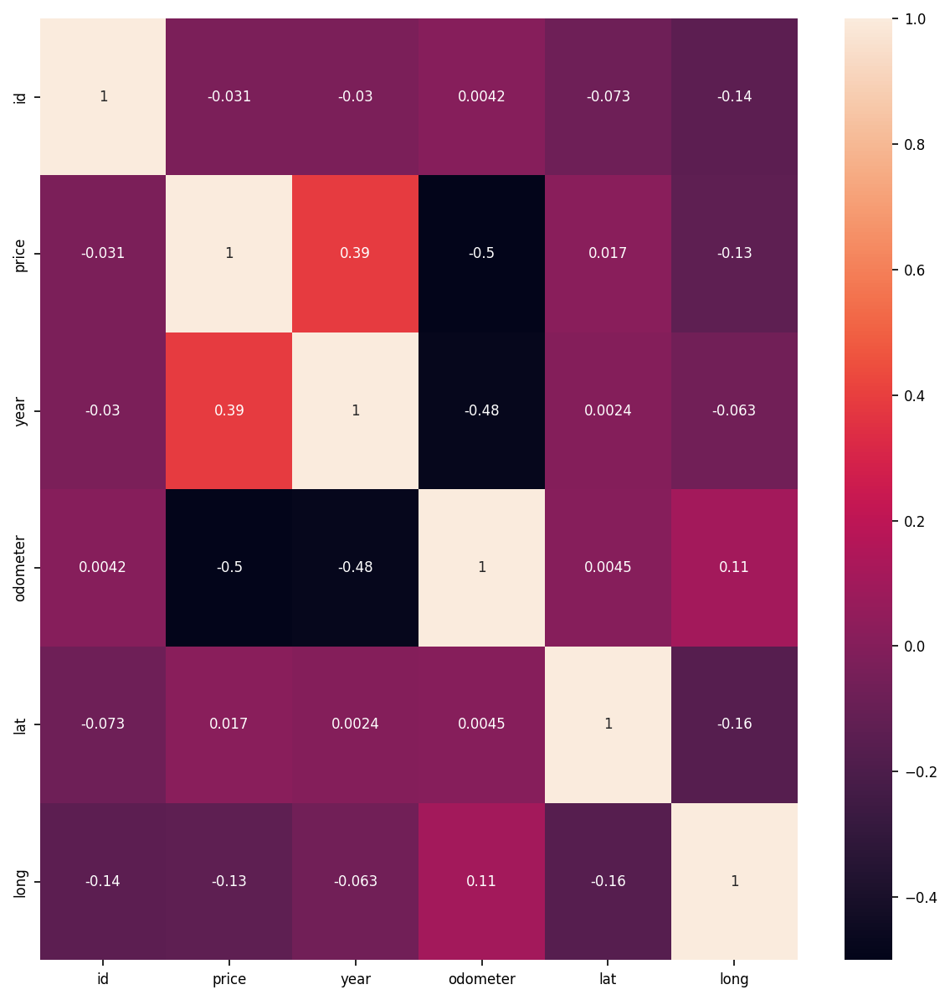

In [94]:
plt.figure(figsize = (8, 8))
sns.heatmap(df.corr(numeric_only=True), annot=True)
plt.show()

There's a positive correlation that indicates that the higher the year of manufacture, the higher its value.
There's a negative correlation between odometer and price indicating the higher the milages, the lower the price.

**Price VS Year**

In [95]:
import plotly.express as px
fig = px.scatter(df, x = 'year', y = 'price', title='Price VS Year',
                 labels={'year': 'Year of manufacture', 'price': 'Price (in $ Dollars)'})
fig.update_xaxes(tickangle=60)
fig.show()

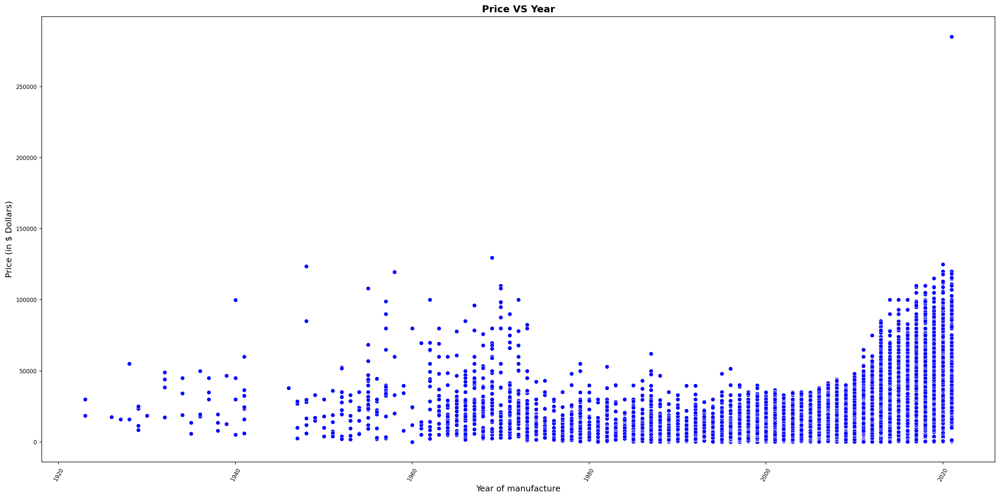

In [96]:
plt.figure(figsize = (20, 10))
sns.scatterplot(data=df, y='price', x='year', color='blue')
plt.title("Price VS Year", fontsize = 14, fontweight = 'bold')
plt.xlabel('Year of manufacture', fontsize = 12)
plt.xticks(rotation=60)
plt.ylabel('Price (in $ Dollars)', fontsize = 12)
plt.tight_layout()
plt.show()

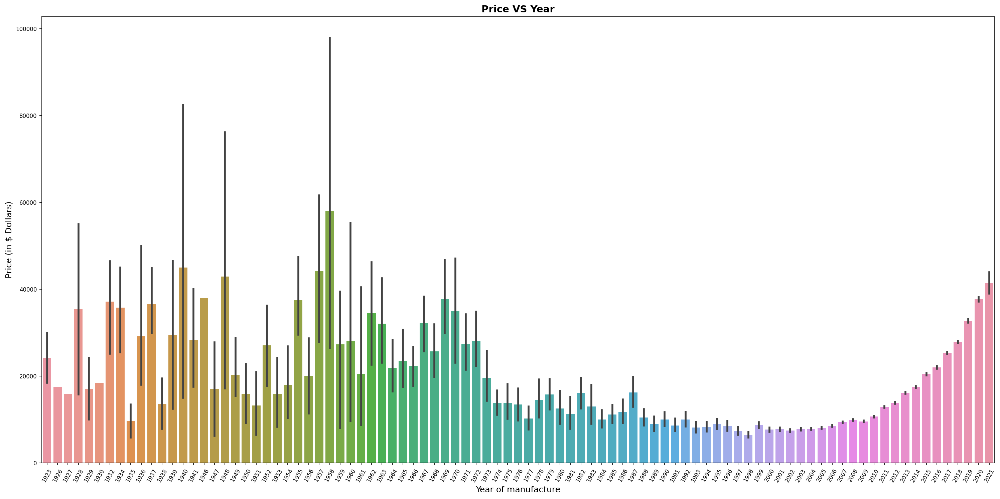

In [97]:
sns.set_palette('summer_r')
plt.figure(figsize = (20, 10))
sns.barplot(data = df, y='price', x = 'year')
plt.title('Price VS Year', fontsize=14, fontweight = 'bold')
plt.xlabel('Year of manufacture', fontsize = 12)
plt.xticks(rotation=60)
plt.ylabel('Price (in $ Dollars)', fontsize = 12)
plt.tight_layout()
plt.show()

The drop in values is very clear. This car leads us to consider that there are two distinct groups of cars, the utility vehicles and the classics. The correlation is very strong between price and year for all cars manufacture after 1998

**Post 1998**

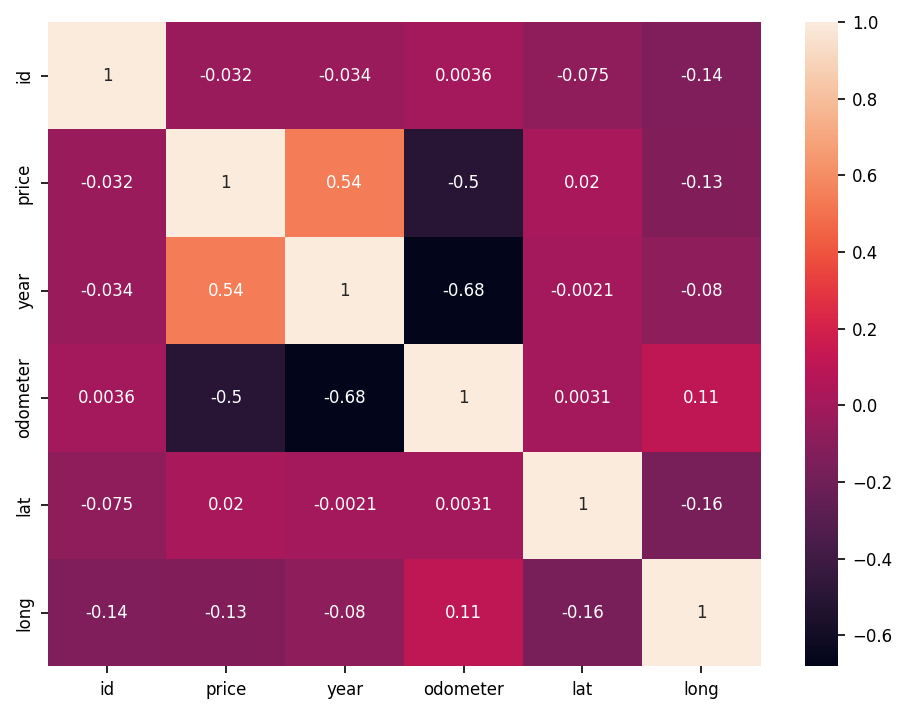

In [98]:
sns.heatmap(df[df['year'] >=1998].corr(numeric_only=True), annot=True)
plt.show()

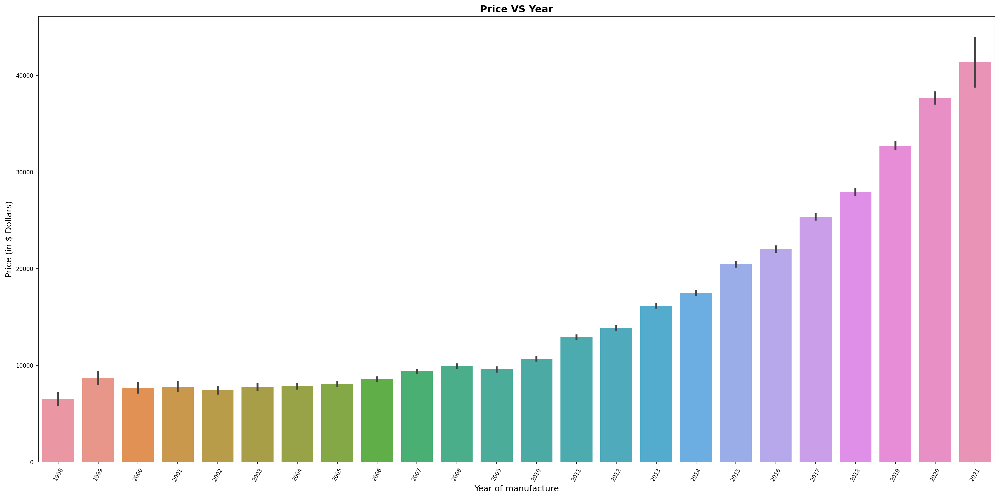

In [99]:
sns.set_palette('summer_r')
plt.figure(figsize = (20, 10))
sns.barplot(data=df[df['year'] >=1998], y='price', x='year')
plt.title('Price VS Year', fontsize=14, fontweight = 'bold')
plt.xlabel('Year of manufacture', fontsize = 12)
plt.xticks(rotation=60)
plt.ylabel('Price (in $ Dollars)', fontsize = 12)
plt.tight_layout()
plt.show()

**Pre 1998**

Here the age adds value to the car

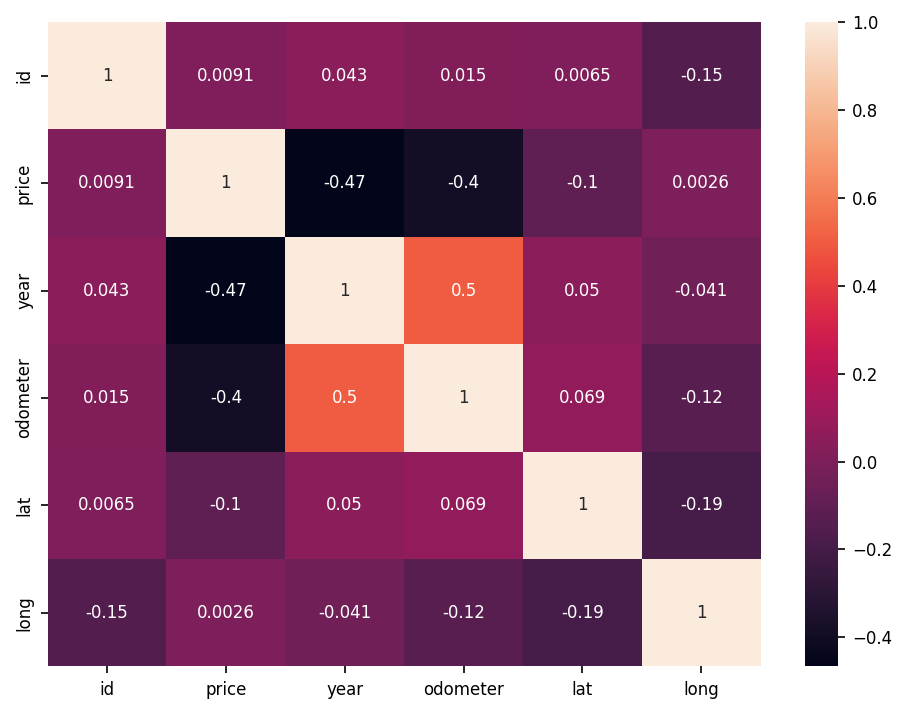

In [100]:
sns.heatmap(df[df['year'] < 1998].corr(numeric_only=True), annot=True)
plt.show()

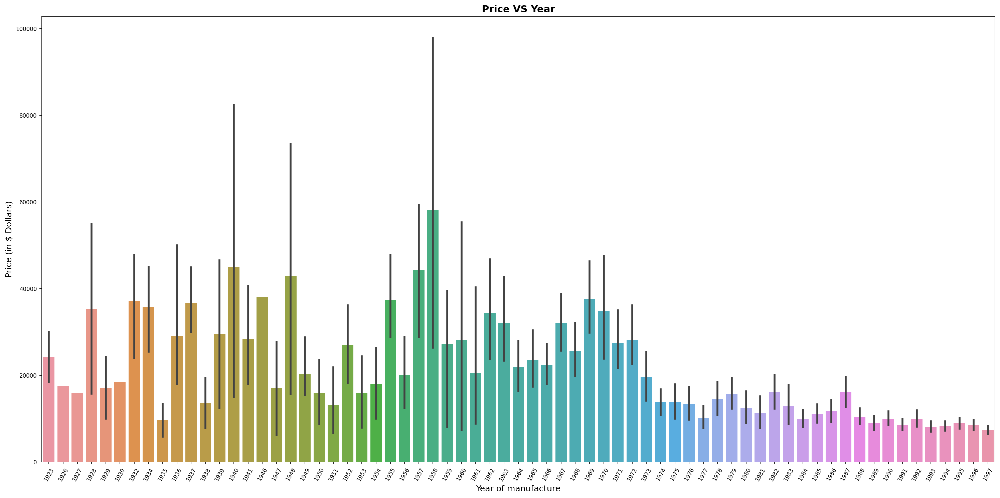

In [101]:
sns.set_palette('summer_r')
plt.figure(figsize = (20, 10))
sns.barplot(data=df[df['year'] < 1998], y='price', x='year')
plt.title('Price VS Year', fontsize=14, fontweight = 'bold')
plt.xlabel('Year of manufacture', fontsize = 12)
plt.xticks(rotation=60)
plt.ylabel('Price (in $ Dollars)', fontsize = 12)
plt.tight_layout()
plt.show()

**Price VS Odometer**

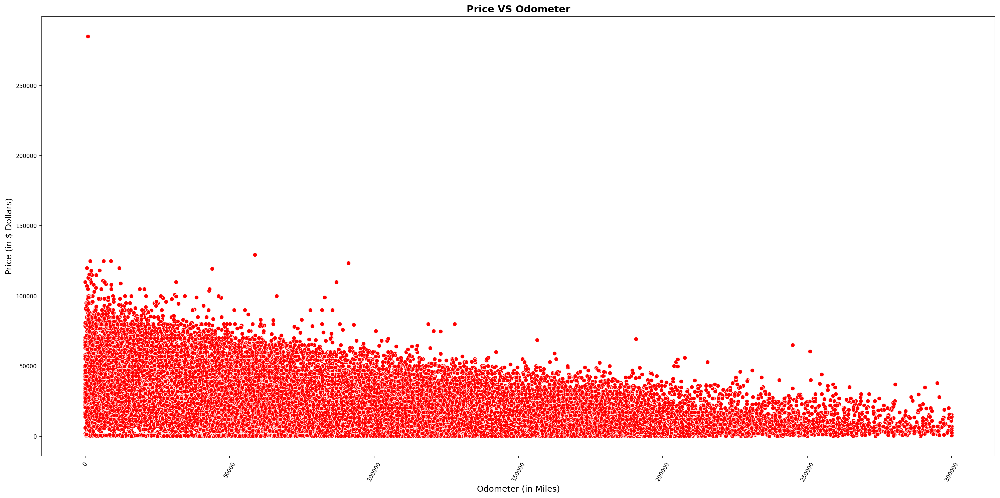

In [102]:
plt.figure(figsize = (20, 10))
sns.scatterplot(data=df, y='price', x='odometer', color='red')
plt.title("Price VS Odometer", fontsize = 14, fontweight='bold')
plt.xlabel('Odometer (in Miles)', fontsize = 12)
plt.xticks(rotation=60)
plt.ylabel('Price (in $ Dollars)', fontsize = 12)
plt.tight_layout()
plt.show()


The trend is clear and explains the negative correlation that the higher the milage the lower the price.

**Pairplot**


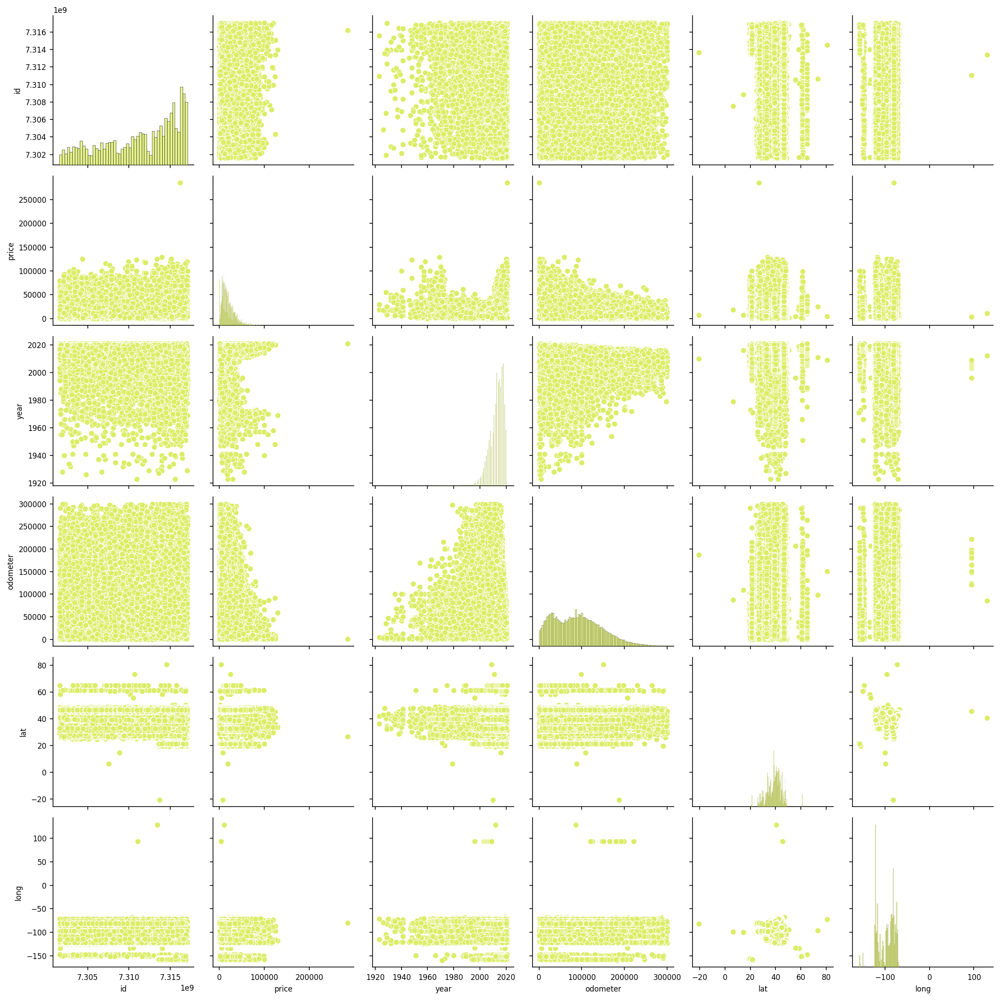

In [103]:
sns.pairplot(data=df)
plt.show()

**Feature distribution**

**Odometer**

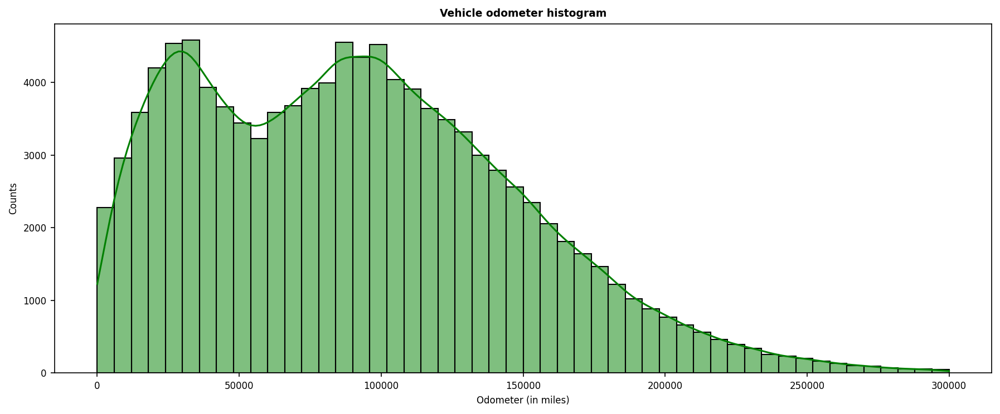

In [104]:
plt.figure(figsize = (12, 5))
sns.histplot(data=df, x='odometer', bins=50, kde=True, color='green')
plt.title('Vehicle odometer histogram', fontsize=9, fontweight = 'bold')
plt.xlabel('Odometer (in miles)')
plt.ylabel('Counts')
plt.tight_layout()
plt.show()

In [105]:
print('mean:', round(df['odometer'].mean(), 3))
print('median:', round(df['odometer'].median(), 3))

mean: 91274.884
median: 87168.0


**Year**

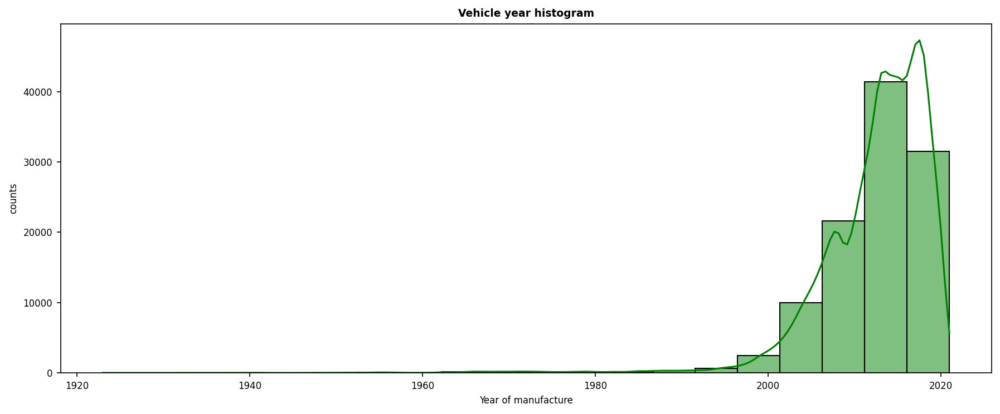

In [106]:
plt.figure(figsize = (12, 5))
sns.histplot(data=df, x='year', bins=20, kde=True, color='green')
plt.title('Vehicle year histogram', fontsize=9, fontweight='bold')
plt.xlabel('Year of manufacture')
plt.ylabel('counts')
plt.tight_layout()
plt.show()


The distribution is rightly skewed meaning most vehicles fall into the utility car range(1998 - 2021)
This is because the classic car market is a more exclusive and less demanded market.

In [107]:
print('mean:', round(df['year'].mean(), 3))
print('median:', round(df['year'].median(), 3))

mean: 2012.523
median: 2014.0


**Price**

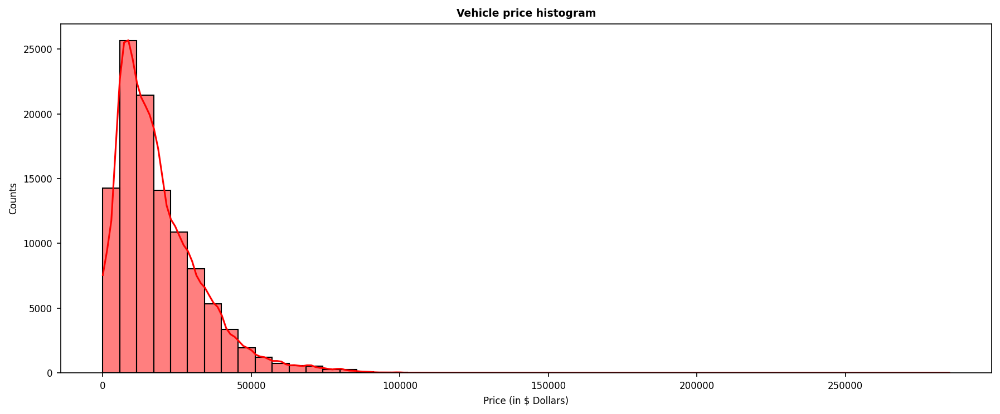

In [108]:
plt.figure(figsize =(12, 5))
sns.histplot(data=df, x='price', bins=50, kde=True, color='red')
plt.title('Vehicle price histogram', fontsize=9, fontweight = 'bold')
plt.xlabel('Price (in $ Dollars)')
plt.ylabel('Counts')
plt.tight_layout()
plt.show()

In [109]:
print('mean:', round(df['price'].mean(), 3))
print('median:', round(df['price'].median(), 3))

mean: 18822.946
median: 15000.0


Most cars are selling at a price of USD19,990 and USD22, 500

In [110]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 108751 entries, 8 to 426861
Data columns (total 22 columns):
 #   Column        Non-Null Count   Dtype              
---  ------        --------------   -----              
 0   id            108751 non-null  int64              
 1   region        108751 non-null  object             
 2   price         108751 non-null  int64              
 3   year          108751 non-null  int64              
 4   manufacturer  108751 non-null  object             
 5   model         108751 non-null  object             
 6   condition     108751 non-null  object             
 7   cylinders     108751 non-null  object             
 8   fuel          108751 non-null  object             
 9   odometer      108751 non-null  int64              
 10  title_status  108751 non-null  object             
 11  transmission  108751 non-null  object             
 12  VIN           108751 non-null  object             
 13  drive         108751 non-null  object       

Let's have a general look at the other catorical columns and have a view on vehicles sold more interms of manufacturer, paint_color, type, fuel, and model.

**Manufacturer**

In [111]:
manufacturer_counts = df['manufacturer'].value_counts()

# Create a DF with the counts and the corresponding condition values
manufacturer_df = pd.DataFrame({'Manufacturer': manufacturer_counts.index, 'Count': manufacturer_counts.values})

# create a bar chart
fig = px.bar(manufacturer_df, x='Manufacturer', y='Count', title='Count of Vehicles by manufacturer')
fig.show()

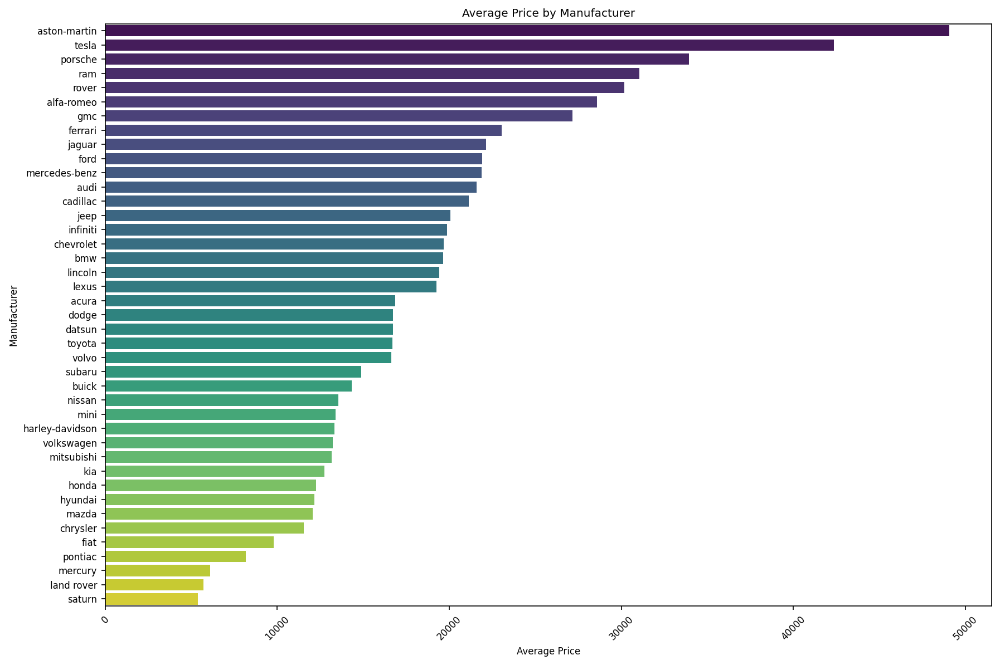

In [112]:
manufacturer_prices = df.groupby('manufacturer')['price'].mean().reset_index()

manufacturer_prices = manufacturer_prices.sort_values(by='price', ascending=False)

plt.figure(figsize=(12, 8))
sns.barplot(x='price', y='manufacturer', data=manufacturer_prices, palette='viridis')
plt.title('Average Price by Manufacturer')
plt.xlabel('Average Price')
plt.ylabel('Manufacturer')
plt.xticks(rotation=45)

plt.show()

We can see even though ford had the highest listing on the website , most cars sold averagely are astorn-martin, porsche, again this are high luxury cars and we will need to dive deeper to understand why they sell most.

**Region**

We would like to understand the demand and supply dynamics by region and vehicle type.


In [114]:
!pip install h3
!pip install keplergl
!pip install h3pandas


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 16.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.7/9.7 MB 61.2 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Using cached jedi-0.19.1-py2.py3-none-any.whl (1.6 MB)
  Created wheel for keplergl: filename=keplergl-0.3.2-py2.py3-none-any.whl size=17922316 sha256=dc3a554d3704d4feb9837013f4927c990e152dcce9cbbe6fd2075d554f480df7
  Stored in directory: /root/.cache/pip/wheels/e5/e9/db/b8b8f2fcb5cb1cd7268d88959fce267bc00697cb8f50dcd0d9
Successfully built keplergl
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.2/115.2 kB 3.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for h3pandas: filename=h3pandas-0.2.4-py3-none-any.whl size=17657 sha256=65b349835f7c7e2a922cfbcacbd19de4eb7091fc054abc9f32ca0c3e5bdb944f
  Stored in directory: /root/.cache/pip/wheels/b7/c1/a1/cfc5bbcd909a037e628ab

In [115]:
import folium
from IPython.display import Image
import branca.colormap as cm
import h3
import ipywidgets
import keplergl
import h3pandas
from keplergl import KeplerGl

In [116]:
# Let' check price's in relation to region and understand where most sales are distributed
fig = px.scatter_mapbox(df.groupby(['lat','long'])['price'].mean().reset_index(), lat='lat', lon='long', hover_data=['price'], zoom=4, height=300)
fig.update_layout(mapbox_style='open-street-map')
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

Sales are in form of clusters but  most are on the eastern regions of US, that is New york, Washington, around that area

In [117]:
N = 50

fig = px.bar(
    df.groupby(['region'])['price'].mean().reset_index().nlargest(N, 'price'),
    x='region',
    y='price',
    color='price',
    text='price'
)

fig.show()

In [118]:
# Let's create hexagons for type and average price
hex_level = 5

df['hex_id'] = df.apply(lambda x: h3.geo_to_h3(x['lat'], x['long'], hex_level), axis=1)
 # Group by hex_id and calcualte avearge price for each hexagon and type
hex_price = df.groupby(['hex_id', 'type'])['price'].mean().reset_index(name='average_price')
hex_price['center'] = hex_price['hex_id'].apply(lambda x: h3.h3_to_geo(x))

# Create a colormap
color_range = [hex_price['average_price'].min(), hex_price['average_price'].max()]
colormap = cm.LinearColormap(['purple', 'red', 'orange', 'yellow', 'green'], vmin=min(color_range), vmax=max(color_range))

# Calculate map center
mean_lat, mean_lon = hex_price['center'].apply(lambda x: x[0]).mean(), hex_price['center'].apply(lambda x: x[1]).mean()
map_center = [mean_lat, mean_lon]
m = folium.Map(location=map_center, zoom_start=6, tiles='Stamen Terrain')

for _, row in hex_price.iterrows():
  folium.Polygon(
      locations=h3.h3_to_geo_boundary(row['hex_id']),
      fill=True,
      fill_color=colormap(row['average_price']),
      fill_opacity=0.7,
      stroke=False,
      toolip=f"Type: {row['type']}<br>Average Price: ${row['average_price']:.2f}"
  ).add_to(m)

colormap.caption = 'Average Price by Type'
m.add_child(colormap)

In [119]:
df['type'].unique()

array(['other', '', 'Truck', 'pickup', 'PICKUP', 'suv', 'TRUCK', 'SUV',
       'Pickup', 'Hatchback', 'Sedan', 'truck', 'Convertible', 'sedan',
       'Wagon', 'OTHER', 'hatchback', 'Other', 'SEDAN', 'CONVERTIBLE',
       'wagon', 'convertible', 'HATCHBACK', 'WAGON', 'Suv', 'PickUp',
       'tRucK', 'sUV', 'TRuck', 'HatchBack'], dtype=object)

In [121]:
# Standardize 'type' values to lowercase and remove leading/trailing whitespace
df['type'] = df['type'].str.lower().str.strip()

# Replace any specific values with standardized versions
df['type'].replace({
    'PICKUP': 'pickup',
    'Pickup':'pickup',
    'Truck': 'truck',
    'tRuck':'truck',
    'TRUCK':'truck',
    'TRuck':'truck',
    'sUV':'suv',
    'suv': 'suv',
    'SUV':'suv',
    'hatchback': 'hatchback',
    'HATCHBACK':'hatchback',
    'Hatchback':'hatchback',
    'SEDAN':'sedan',
    'sedan': 'sedan',
    'Sedan':'sedan',
    'convertible': 'convertible',
    'Convertible':'convertible',
    'CONVERTIBLE':'convertible',
    'wagon': 'wagon',
    'Wagon':'wagon',
    'WAGON':'wagon',
    'Other':'other',
    'OTHER':'other',
    'other': 'other'
}, inplace=True)


In [123]:
df = df[df['type'] != '']
df['type'].unique()

array(['other', 'truck', 'pickup', 'suv', 'hatchback', 'sedan',
       'convertible', 'wagon'], dtype=object)

In [126]:
type_counts = df['type'].value_counts()

# Create a DF with the counts and the corresponding condition values
type_df = pd.DataFrame({'Type': type_counts.index, 'Count': type_counts.values})

# create a bar chart
fig = px.bar(type_df, x='Type', y='Count', title='Count of Vehicles by Type')
fig.show()

In [129]:
import plotly.express as px

# Sort the DataFrame in descending order by the 'price' column
sorted_df = df.groupby(['type'])['price'].mean().reset_index()
sorted_df = sorted_df.sort_values(by='price', ascending=False)

fig = px.bar(
    sorted_df,
    x='type',
    y='price',
    color='price',
    text='price'
)

fig.show()


## Time Series Modelling

We will utilize the posting_date column to create a datetime index for the dataset.


In [159]:
df.head()

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,...,VIN,drive,size,type,paint_color,description,lat,long,removal_date,hex_id
posting_date,,,,,,,,,,,,,,,,,,,,,
2021-04-18 00:00:00+00:00,7308988448,abilene,11125,2014,toyota,camry,good,,gas,51534,...,4T4BF1FK1ER378075,,,other,Grey,2014 Grey Toyota Camry LE 4 dr with very clean...,32.339483,-99.669829,2021-05-11 00:00:00+00:00,8526d97bfffffff
2021-04-26 00:00:00+00:00,7313061478,abilene,20995,2008,ford,super duty f-350 srw,excellent,,diesel,211298,...,1FTWW31R98EA47287,4WD,,truck,Black,2008 Ford Super Duty F-350_ F350_ f350_ F 350_...,32.965063,-96.913304,2021-05-18 00:00:00+00:00,8526c863fffffff
2021-04-26 00:00:00+00:00,7313061591,abilene,18995,2010,ford,super duty f-350 drw,excellent,,diesel,169999,...,1FTWW3CR9AEB05371,RWD,,truck,White,2010 Ford Super Duty F-350_ F350_ f350_ F 350_...,32.965063,-96.913304,2021-05-03 00:00:00+00:00,8526c863fffffff
2021-04-26 00:00:00+00:00,7313061870,abilene,38995,2012,ram,3500,excellent,,diesel,127999,...,3C63DRAL1CG191790,4WD,,truck,White,2012 RAM 3500 4WD Reg Cab 140.5 📲 ☎ Call or...,32.965063,-96.913304,2021-05-09 00:00:00+00:00,8526c863fffffff
2021-04-26 00:00:00+00:00,7313061731,abilene,21995,2014,jeep,wrangler,excellent,,gas,106377,...,1C4AJWAG0EL245211,4WD,,truck,White,2014 Jeep WRANGLER SPORT 📲 ☎ Call or text Lo...,32.965063,-96.913304,2021-04-27 00:00:00+00:00,8526c863fffffff


In [162]:
df.head()

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,...,type,paint_color,description,lat,long,removal_date,hex_id,day,month,daily_ma
posting_date,,,,,,,,,,,,,,,,,,,,,
2021-04-18 00:00:00+00:00,7308988448,abilene,11125,2021,toyota,camry,good,,gas,51534,...,other,Grey,2014 Grey Toyota Camry LE 4 dr with very clean...,32.339483,-99.669829,2021-05-11 00:00:00+00:00,8526d97bfffffff,18,4,11125.000000
2021-04-26 00:00:00+00:00,7313061478,abilene,20995,2021,ford,super duty f-350 srw,excellent,,diesel,211298,...,truck,Black,2008 Ford Super Duty F-350_ F350_ f350_ F 350_...,32.965063,-96.913304,2021-05-18 00:00:00+00:00,8526c863fffffff,26,4,16060.000000
2021-04-26 00:00:00+00:00,7313061591,abilene,18995,2021,ford,super duty f-350 drw,excellent,,diesel,169999,...,truck,White,2010 Ford Super Duty F-350_ F350_ f350_ F 350_...,32.965063,-96.913304,2021-05-03 00:00:00+00:00,8526c863fffffff,26,4,17038.333333
2021-04-26 00:00:00+00:00,7313061870,abilene,38995,2021,ram,3500,excellent,,diesel,127999,...,truck,White,2012 RAM 3500 4WD Reg Cab 140.5 📲 ☎ Call or...,32.965063,-96.913304,2021-05-09 00:00:00+00:00,8526c863fffffff,26,4,22527.500000
2021-04-26 00:00:00+00:00,7313061731,abilene,21995,2021,jeep,wrangler,excellent,,gas,106377,...,truck,White,2014 Jeep WRANGLER SPORT 📲 ☎ Call or text Lo...,32.965063,-96.913304,2021-04-27 00:00:00+00:00,8526c863fffffff,26,4,22421.000000


In [163]:
df['year'].unique()

array([2021])

In [168]:
df['month'].unique()

array([4, 5])

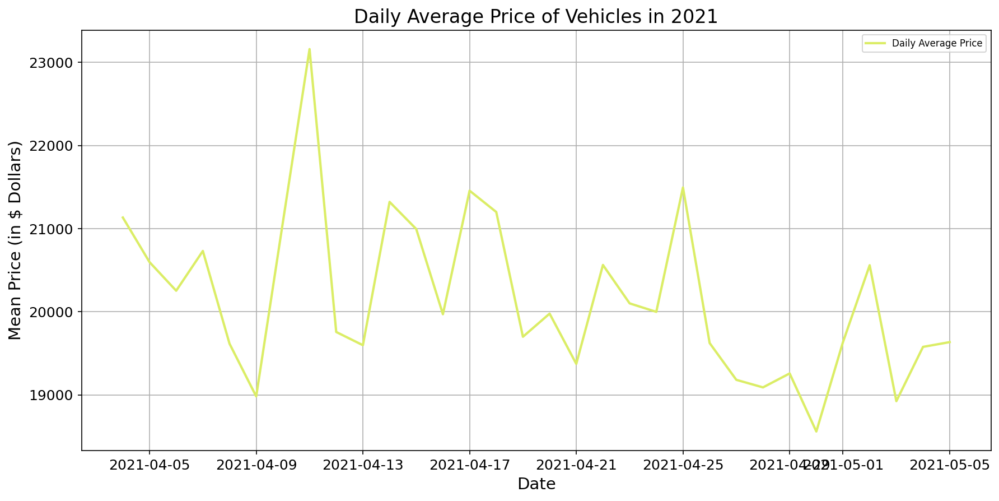

In [166]:

from datetime import datetime

# Extract the day and month
df['day'] = df.index.day
df['month'] = df.index.month

# Calculate daily average prices
daily_avg_prices = df.groupby(['month', 'day'])['price'].mean()

# Create a time series plot
plt.figure(figsize=(12, 6))

# Create a date format that Matplotlib can understand
date_format = [datetime(2021, month, day) for month, day in daily_avg_prices.index]

plt.plot(date_format, daily_avg_prices.values, label='Daily Average Price', linewidth=2)

plt.title('Daily Average Price of Vehicles in 2021', fontsize=16)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Mean Price (in $ Dollars)', fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.legend()
plt.grid(True)
plt.show()


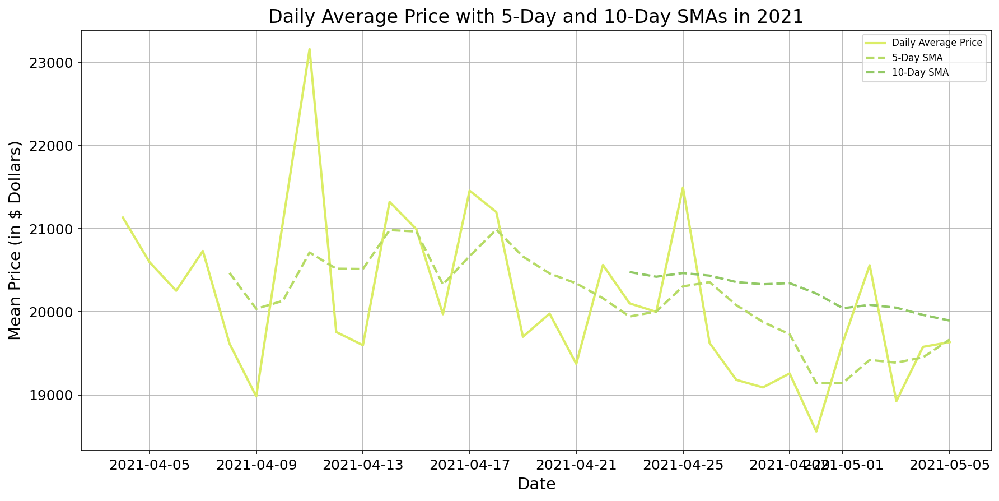

In [169]:
from datetime import datetime

df['day'] = df.index.day
df['month'] = df.index.month

daily_avg_prices2 = df.groupby(['month', 'day'])['price'].mean()

# Calculate a 5-day SMA
sma_5 = daily_avg_prices2.rolling(window=5).mean()

# 10_day SMA
sma_10 = daily_avg_prices2.rolling(window=20).mean()

# Create a time series plot
plt.figure(figsize=(12, 6))

date_format = [datetime(2021, month, day) for month, day in daily_avg_prices2.index]

plt.plot(date_format, daily_avg_prices2.values, label='Daily Average Price', linewidth=2)
plt.plot(date_format, sma_5.values, label='5-Day SMA', linestyle='--', linewidth=2)
plt.plot(date_format, sma_10.values, label='10-Day SMA', linestyle='--', linewidth=2)

plt.title('Daily Average Price with 5-Day and 10-Day SMAs in 2021', fontsize=16)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Mean Price (in $ Dollars)', fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.legend()
plt.grid(True)
plt.show()